# Plots of temperature and feedbacks vs. time

By: Ty Janoski

Updated: 03.25.22

## Set-up

In [1]:
# import statements
import xarray as xr
import matplotlib.pyplot as plt
import numpy as np
import scipy.stats as stats
import hvplot.xarray

%matplotlib inline
%config InlineBackend.figure_format = "jpg"

In [2]:
def get_pvals(da):
    """
    Calculate the p-values of a dataarray along the first axis using
    a 1-sample t-test with assumed population mean of 0.
    
    Parameters
    ----------
    da : xarray.DataArray
        DataArray with ensemble as its first dimension.
        
    Returns
    -------
    pvals : numpy array
        Numpy array of same shape of da with first dimension removed.
    """
    return(stats.ttest_1samp(da,axis=0,popmean=0)[1])

## Temp vs. time

### Land & Ocean

In [3]:
dSAT_jan_glb = xr.open_dataarray('/dx02/janoski/cesm/spat_avg_feedbacks/all/b40.1850.cam5-lens.01.glb_dSAT.nc')
dSAT_jan_arc = xr.open_dataarray('/dx02/janoski/cesm/spat_avg_feedbacks/all/b40.1850.cam5-lens.01.arc_dSAT.nc')
dSAT_jul_glb = xr.open_dataarray('/dx02/janoski/cesm/spat_avg_feedbacks/all/b40.1850.cam5-lens.07.glb_dSAT.nc')
dSAT_jul_arc = xr.open_dataarray('/dx02/janoski/cesm/spat_avg_feedbacks/all/b40.1850.cam5-lens.07.arc_dSAT.nc')
dev_jan = dSAT_jan_arc - dSAT_jan_glb
dev_jul = dSAT_jul_arc - dSAT_jul_glb

# 1-sample t-test so see if local deviation of Arctic warming is
# statistically different from 0
dev_jan_t,dev_jan_p = stats.ttest_1samp(dev_jan,axis=0,popmean=0)
dev_jul_t,dev_jul_p = stats.ttest_1samp(dev_jul,axis=0,popmean=0)

In [4]:
# Get some variables for relabeling the x-axes
first_days_jan = np.array([1,91,182,274])

x_vals_jan = np.concatenate((first_days_jan,first_days_jan+365))
x_labs_jan = np.tile(['Jan 1','Apr 1','Jul 1','Oct 1'],
                 (2))

first_days_jul = np.array([1,92,184,274])
x_vals_jul = np.concatenate((first_days_jul,first_days_jul+365))
x_labs_jul = np.tile(['Jul 1','Oct 1','Jan 1','Apr 1'],
                 (2))

xs=np.arange(1,731,1)

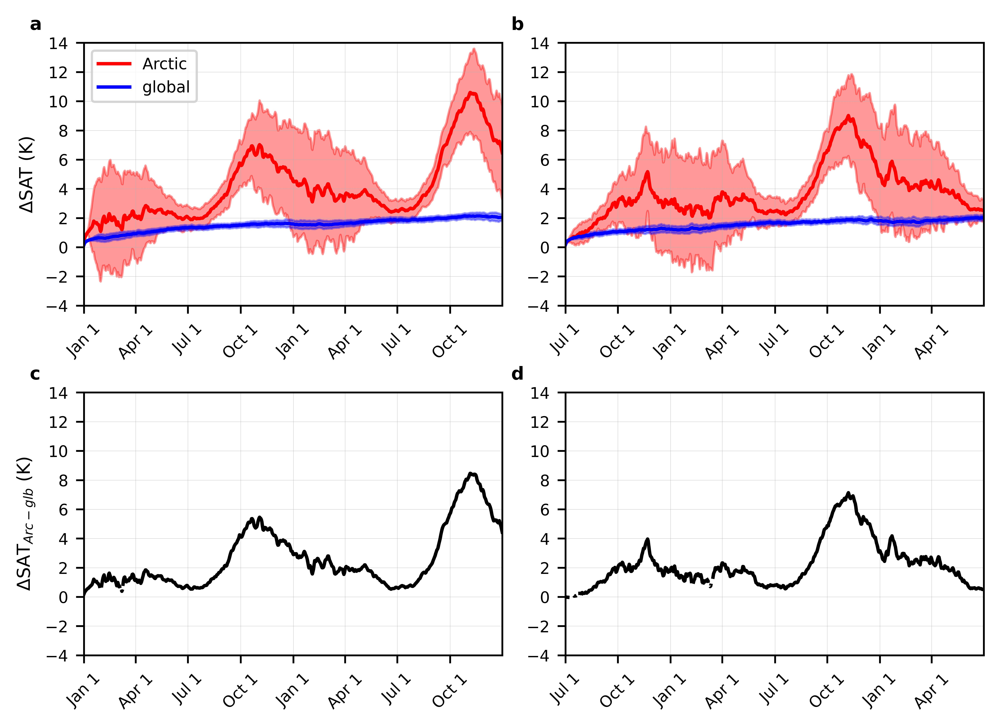

In [5]:
fig, axes = plt.subplots(ncols=2,nrows=2,sharey=True,figsize=(6.27,4.47),dpi=1000)

for ax in axes.flatten():
    ax.grid(linewidth=0.1)
    ax.set_xlim(1,730)
    ax.tick_params(axis='x', rotation=45,labelsize=7)
    ax.tick_params(axis='both',labelsize=7)
    ax.tick_params(labelleft=True)
    ax.set_ylim(-4,14)
    ax.set_yticks(np.arange(-4,15,2))
    
# top-left
axes[0,0].plot(xs,dSAT_jan_arc.mean(dim='ens'),color='red',label='Arctic')
axes[0,0].fill_between(xs,dSAT_jan_arc.mean(dim='ens')-dSAT_jan_arc.std(dim='ens'),
                       dSAT_jan_arc.mean(dim='ens')+dSAT_jan_arc.std(dim='ens'),alpha=0.4,
                      color='red')

axes[0,0].plot(xs,dSAT_jan_glb.mean(dim='ens'),color='blue',label='global')
axes[0,0].fill_between(xs,dSAT_jan_glb.mean(dim='ens')-dSAT_jan_glb.std(dim='ens'),
                       dSAT_jan_glb.mean(dim='ens')+dSAT_jan_glb.std(dim='ens'),alpha=0.4,
                      color='blue')
axes[0,0].set_xticks(x_vals_jan)
axes[0,0].set_xticklabels(x_labs_jan)
axes[0,0].set_ylabel(r'ΔSAT (K)',fontsize=8)
axes[0,0].legend(fontsize=7,loc='upper left')

# top-right
axes[0,1].plot(xs,dSAT_jul_arc.mean(dim='ens'),color='red',label='Arctic')
axes[0,1].fill_between(xs,dSAT_jul_arc.mean(dim='ens')-dSAT_jul_arc.std(dim='ens'),
                       dSAT_jul_arc.mean(dim='ens')+dSAT_jul_arc.std(dim='ens'),alpha=0.4,
                      color='red')

axes[0,1].plot(xs,dSAT_jul_glb.mean(dim='ens'),color='blue',label='global')
axes[0,1].fill_between(xs,dSAT_jul_glb.mean(dim='ens')-dSAT_jul_glb.std(dim='ens'),
                       dSAT_jul_glb.mean(dim='ens')+dSAT_jul_glb.std(dim='ens'),alpha=0.4,
                      color='blue')
axes[0,1].set_xticks(x_vals_jul)
axes[0,1].set_xticklabels(x_labs_jul)
# axes[0,1].set_ylabel(r'ΔSAT (K), 4xCO$_2$',fontsize=8)

# bottom-left
axes[1,0].plot(xs,dev_jan.mean(dim='ens'),color='black',
               linestyle=':')
axes[1,0].plot(xs,(dev_jan.mean(dim='ens')).where(dev_jan_p<0.05),color='black')

axes[1,0].set_xticks(x_vals_jan)
axes[1,0].set_xticklabels(x_labs_jan)
axes[1,0].set_ylabel('ΔSAT$_{Arc-glb}$ (K)',fontsize=8)

# bottom-right
axes[1,1].plot(xs,dev_jul.mean(dim='ens'),color='black',
               linestyle=':')
axes[1,1].plot(xs,(dev_jul.mean(dim='ens')).where(dev_jul_p<0.05),color='black')

axes[1,1].set_xticks(x_vals_jul)
axes[1,1].set_xticklabels(x_labs_jul)

plt.tight_layout()
plt.text(-0.13,1.05,'a',fontweight='bold',fontsize=8,transform=axes[0,0].transAxes)
plt.text(-0.13,1.05,'b',fontweight='bold',fontsize=8,transform=axes[0,1].transAxes)
plt.text(-0.13,1.05,'c',fontweight='bold',fontsize=8,transform=axes[1,0].transAxes)
plt.text(-0.13,1.05,'d',fontweight='bold',fontsize=8,transform=axes[1,1].transAxes)

# plt.show()
plt.savefig('Fig1_SAT_time_series.jpg',dpi=1000,bbox_inches='tight')

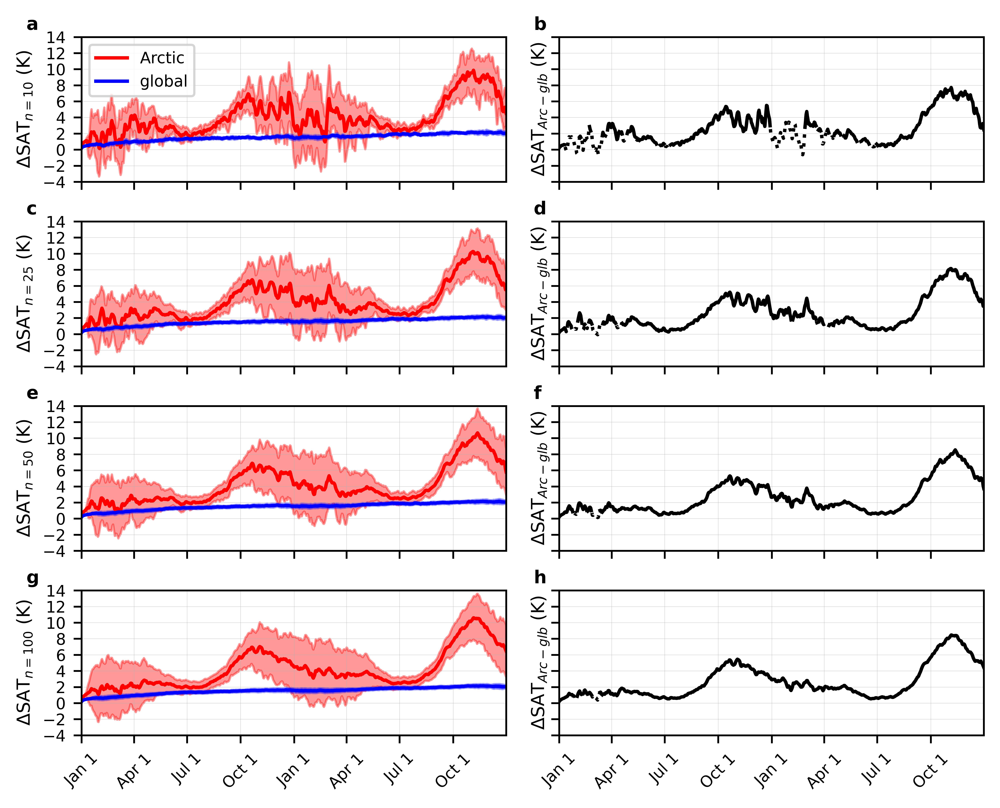

In [6]:
fig, axes = plt.subplots(ncols=2,nrows=4,sharey=True,
                         sharex=True,figsize=(6.27,5),dpi=1000)

for ax in axes.flatten():
    ax.grid(linewidth=0.1)
    ax.set_xlim(1,730)
    ax.tick_params(axis='x', rotation=45,labelsize=7)
    ax.tick_params(axis='both',labelsize=7)
    # ax.tick_params(labelleft=True)
    ax.set_ylim(-4,14)
    ax.set_yticks(np.arange(-4,15,2))
    
# top-left
axes[0,0].plot(xs,dSAT_jan_arc.isel(ens=slice(None,10)).mean(dim='ens'),color='red',label='Arctic')
axes[0,0].fill_between(xs,dSAT_jan_arc.isel(ens=slice(None,10)).mean(dim='ens')-
                       dSAT_jan_arc.isel(ens=slice(None,10)).std(dim='ens'),
                       dSAT_jan_arc.isel(ens=slice(None,10)).mean(dim='ens')+
                       dSAT_jan_arc.isel(ens=slice(None,10)).std(dim='ens'),alpha=0.4,
                      color='red')

axes[0,0].plot(xs,dSAT_jan_glb.isel(ens=slice(None,10)).mean(dim='ens'),color='blue',label='global')
axes[0,0].fill_between(xs,dSAT_jan_glb.isel(ens=slice(None,10)).mean(dim='ens')-
                       dSAT_jan_glb.isel(ens=slice(None,10)).std(dim='ens'),
                       dSAT_jan_glb.isel(ens=slice(None,10)).mean(dim='ens')+
                       dSAT_jan_glb.isel(ens=slice(None,10)).std(dim='ens'),alpha=0.4,
                      color='blue')
axes[0,0].set_xticks(x_vals_jan)
axes[0,0].set_xticklabels(x_labs_jan)
axes[0,0].set_ylabel(r'ΔSAT$_{n=10}$ (K)',fontsize=8)
axes[0,0].legend(fontsize=7,loc='upper left')

# top-right
axes[0,1].plot(xs,dev_jan.isel(ens=slice(None,10)).mean(dim='ens'),color='black',
               linestyle=':')
axes[0,1].plot(xs,(dev_jan.isel(ens=slice(None,10)).mean(dim='ens')).where(get_pvals(dev_jan.isel(
    ens=slice(None,10)))<.05),color='black')

axes[0,1].set_xticks(x_vals_jan)
axes[0,1].set_xticklabels(x_labs_jan)
axes[0,1].set_ylabel('ΔSAT$_{Arc-glb}$ (K)',fontsize=8)

# 2nd row

axes[1,0].plot(xs,dSAT_jan_arc.isel(ens=slice(None,25)).mean(dim='ens'),color='red',label='Arctic')
axes[1,0].fill_between(xs,dSAT_jan_arc.isel(ens=slice(None,25)).mean(dim='ens')-
                       dSAT_jan_arc.isel(ens=slice(None,25)).std(dim='ens'),
                       dSAT_jan_arc.isel(ens=slice(None,25)).mean(dim='ens')+
                       dSAT_jan_arc.isel(ens=slice(None,25)).std(dim='ens'),alpha=0.4,
                      color='red')

axes[1,0].plot(xs,dSAT_jan_glb.isel(ens=slice(None,25)).mean(dim='ens'),color='blue',label='global')
axes[1,0].fill_between(xs,dSAT_jan_glb.isel(ens=slice(None,25)).mean(dim='ens')-
                       dSAT_jan_glb.isel(ens=slice(None,25)).std(dim='ens'),
                       dSAT_jan_glb.isel(ens=slice(None,25)).mean(dim='ens')+
                       dSAT_jan_glb.isel(ens=slice(None,25)).std(dim='ens'),alpha=0.4,
                      color='blue')
axes[1,0].set_ylabel(r'ΔSAT$_{n=25}$ (K)',fontsize=8)

axes[1,1].plot(xs,dev_jan.isel(ens=slice(None,25)).mean(dim='ens'),color='black',
               linestyle=':')
axes[1,1].plot(xs,(dev_jan.isel(ens=slice(None,25)).mean(dim='ens')).where(get_pvals(dev_jan.isel(
    ens=slice(None,25)))<.05),color='black')

axes[1,1].set_xticks(x_vals_jan)
axes[1,1].set_xticklabels(x_labs_jan)
axes[1,1].set_ylabel('ΔSAT$_{Arc-glb}$ (K)',fontsize=8)

# 3rd row

axes[2,0].plot(xs,dSAT_jan_arc.isel(ens=slice(None,50)).mean(dim='ens'),color='red',label='Arctic')
axes[2,0].fill_between(xs,dSAT_jan_arc.isel(ens=slice(None,50)).mean(dim='ens')-
                       dSAT_jan_arc.isel(ens=slice(None,50)).std(dim='ens'),
                       dSAT_jan_arc.isel(ens=slice(None,50)).mean(dim='ens')+
                       dSAT_jan_arc.isel(ens=slice(None,50)).std(dim='ens'),alpha=0.4,
                      color='red')

axes[2,0].plot(xs,dSAT_jan_glb.isel(ens=slice(None,50)).mean(dim='ens'),color='blue',label='global')
axes[2,0].fill_between(xs,dSAT_jan_glb.isel(ens=slice(None,50)).mean(dim='ens')-
                       dSAT_jan_glb.isel(ens=slice(None,50)).std(dim='ens'),
                       dSAT_jan_glb.isel(ens=slice(None,50)).mean(dim='ens')+
                       dSAT_jan_glb.isel(ens=slice(None,50)).std(dim='ens'),alpha=0.4,
                      color='blue')
axes[2,0].set_ylabel(r'ΔSAT$_{n=50}$ (K)',fontsize=8)

axes[2,1].plot(xs,dev_jan.isel(ens=slice(None,50)).mean(dim='ens'),color='black',
               linestyle=':')
axes[2,1].plot(xs,(dev_jan.isel(ens=slice(None,50)).mean(dim='ens')).where(get_pvals(dev_jan.isel(
    ens=slice(None,50)))<.05),color='black')

axes[2,1].set_xticks(x_vals_jan)
axes[2,1].set_xticklabels(x_labs_jan)
axes[2,1].set_ylabel('ΔSAT$_{Arc-glb}$ (K)',fontsize=8)

# 4th row

axes[3,0].plot(xs,dSAT_jan_arc.mean(dim='ens'),color='red',label='Arctic')
axes[3,0].fill_between(xs,dSAT_jan_arc.mean(dim='ens')-
                       dSAT_jan_arc.std(dim='ens'),
                       dSAT_jan_arc.mean(dim='ens')+
                       dSAT_jan_arc.std(dim='ens'),alpha=0.4,
                      color='red')

axes[3,0].plot(xs,dSAT_jan_glb.mean(dim='ens'),color='blue',label='global')
axes[3,0].fill_between(xs,dSAT_jan_glb.mean(dim='ens')-
                       dSAT_jan_glb.std(dim='ens'),
                       dSAT_jan_glb.mean(dim='ens')+
                       dSAT_jan_glb.std(dim='ens'),alpha=0.4,
                      color='blue')
axes[3,0].set_ylabel(r'ΔSAT$_{n=100}$ (K)',fontsize=8)

axes[3,1].plot(xs,dev_jan.mean(dim='ens'),color='black',
               linestyle=':')
axes[3,1].plot(xs,(dev_jan.mean(dim='ens')).where(get_pvals(dev_jan.isel(
    ens=slice(None,50)))<.05),color='black')

axes[3,1].set_xticks(x_vals_jan)
axes[3,1].set_xticklabels(x_labs_jan)
axes[3,1].set_ylabel('ΔSAT$_{Arc-glb}$ (K)',fontsize=8)

plt.tight_layout()
plt.text(-0.13,1.05,'a',fontweight='bold',fontsize=8,transform=axes[0,0].transAxes)
plt.text(-0.06,1.05,'b',fontweight='bold',fontsize=8,transform=axes[0,1].transAxes)
plt.text(-0.13,1.05,'c',fontweight='bold',fontsize=8,transform=axes[1,0].transAxes)
plt.text(-0.06,1.05,'d',fontweight='bold',fontsize=8,transform=axes[1,1].transAxes)
plt.text(-0.13,1.05,'e',fontweight='bold',fontsize=8,transform=axes[2,0].transAxes)
plt.text(-0.06,1.05,'f',fontweight='bold',fontsize=8,transform=axes[2,1].transAxes)
plt.text(-0.13,1.05,'g',fontweight='bold',fontsize=8,transform=axes[3,0].transAxes)
plt.text(-0.06,1.05,'h',fontweight='bold',fontsize=8,transform=axes[3,1].transAxes)

# plt.show()
plt.savefig('FigS1_SAT_time_series_ensemble_variations.jpg',dpi=1000,bbox_inches='tight')

## TOA Feedbacks vs. time

### Land & Ocean

In [49]:
# january
lead = '/dx02/janoski/cesm/spat_avg_feedbacks/norm_feedbacks/all/b40.1850.cam5-lens.01.arc_'
AHT_arc_jan = xr.open_dataarray(lead+'AHT_expl.nc')
alb_arc_jan = xr.open_dataarray(lead+'alb_TOA.nc')
cloud_LW_arc_jan = xr.open_dataarray(lead+'cloud_LW_TOA.nc')
cloud_SW_arc_jan = xr.open_dataarray(lead+'cloud_SW_TOA.nc')
cloud_arc_jan = cloud_LW_arc_jan + cloud_SW_arc_jan
Fsfc_arc_jan = xr.open_dataarray(lead+'Fsfc.nc')
lapse_arc_jan = xr.open_dataarray(lead+'lapse_tropo_TOA.nc')
planck_arc_jan = xr.open_dataarray(lead+'planck_tropo_TOA.nc')
q_LW_arc_jan = xr.open_dataarray(lead+'q_LW_tropo_TOA.nc')
q_SW_arc_jan = xr.open_dataarray(lead+'q_SW_tropo_TOA.nc')
q_arc_jan = q_LW_arc_jan + q_SW_arc_jan

lead = '/dx02/janoski/cesm/spat_avg_feedbacks/norm_feedbacks/all/b40.1850.cam5-lens.01.glb_'
AHT_glb_jan = xr.open_dataarray(lead+'AHT_expl.nc')
alb_glb_jan = xr.open_dataarray(lead+'alb_TOA.nc')
cloud_LW_glb_jan = xr.open_dataarray(lead+'cloud_LW_TOA.nc')
cloud_SW_glb_jan = xr.open_dataarray(lead+'cloud_SW_TOA.nc')
cloud_glb_jan = cloud_LW_glb_jan + cloud_SW_glb_jan
Fsfc_glb_jan = xr.open_dataarray(lead+'Fsfc.nc')
lapse_glb_jan = xr.open_dataarray(lead+'lapse_tropo_TOA.nc')
planck_glb_jan = xr.open_dataarray(lead+'planck_tropo_TOA.nc')
q_LW_glb_jan = xr.open_dataarray(lead+'q_LW_tropo_TOA.nc')
q_SW_glb_jan = xr.open_dataarray(lead+'q_SW_tropo_TOA.nc')
q_glb_jan = q_LW_glb_jan + q_SW_glb_jan

In [50]:
# jul
lead = '/dx02/janoski/cesm/spat_avg_feedbacks/norm_feedbacks/all/b40.1850.cam5-lens.07.arc_'
AHT_arc_jul = xr.open_dataarray(lead+'AHT_expl.nc')
alb_arc_jul = xr.open_dataarray(lead+'alb_TOA.nc')
cloud_LW_arc_jul = xr.open_dataarray(lead+'cloud_LW_TOA.nc')
cloud_SW_arc_jul = xr.open_dataarray(lead+'cloud_SW_TOA.nc')
cloud_arc_jul = cloud_LW_arc_jul + cloud_SW_arc_jul
Fsfc_arc_jul = xr.open_dataarray(lead+'Fsfc.nc')
lapse_arc_jul = xr.open_dataarray(lead+'lapse_tropo_TOA.nc')
planck_arc_jul = xr.open_dataarray(lead+'planck_tropo_TOA.nc')
q_LW_arc_jul = xr.open_dataarray(lead+'q_LW_tropo_TOA.nc')
q_SW_arc_jul = xr.open_dataarray(lead+'q_SW_tropo_TOA.nc')
q_arc_jul = q_LW_arc_jul + q_SW_arc_jul

lead = '/dx02/janoski/cesm/spat_avg_feedbacks/norm_feedbacks/all/b40.1850.cam5-lens.07.glb_'
AHT_glb_jul = xr.open_dataarray(lead+'AHT_expl.nc')
alb_glb_jul = xr.open_dataarray(lead+'alb_TOA.nc')
cloud_LW_glb_jul = xr.open_dataarray(lead+'cloud_LW_TOA.nc')
cloud_SW_glb_jul = xr.open_dataarray(lead+'cloud_SW_TOA.nc')
cloud_glb_jul = cloud_LW_glb_jul + cloud_SW_glb_jul
Fsfc_glb_jul = xr.open_dataarray(lead+'Fsfc.nc')
lapse_glb_jul = xr.open_dataarray(lead+'lapse_tropo_TOA.nc')
planck_glb_jul = xr.open_dataarray(lead+'planck_tropo_TOA.nc')
q_LW_glb_jul = xr.open_dataarray(lead+'q_LW_tropo_TOA.nc')
q_SW_glb_jul = xr.open_dataarray(lead+'q_SW_tropo_TOA.nc')
q_glb_jul = q_LW_glb_jul + q_SW_glb_jul

In [51]:
# diff
AHT_diff_jan = AHT_arc_jan - AHT_glb_jan
alb_diff_jan = alb_arc_jan - alb_glb_jan
cloud_LW_diff_jan = cloud_LW_arc_jan - cloud_LW_glb_jan
cloud_SW_diff_jan = cloud_SW_arc_jan - cloud_SW_glb_jan
cloud_diff_jan = cloud_LW_diff_jan + cloud_SW_diff_jan
Fsfc_diff_jan = Fsfc_arc_jan - Fsfc_glb_jan
lapse_diff_jan = lapse_arc_jan - lapse_glb_jan
planck_diff_jan = planck_arc_jan - planck_glb_jan
q_LW_diff_jan = q_LW_arc_jan - q_LW_glb_jan
q_SW_diff_jan = q_SW_arc_jan - q_SW_glb_jan
q_diff_jan = q_LW_diff_jan + q_SW_diff_jan

AHT_diff_jul = AHT_arc_jul - AHT_glb_jul
alb_diff_jul = alb_arc_jul - alb_glb_jul
cloud_LW_diff_jul = cloud_LW_arc_jul - cloud_LW_glb_jul
cloud_SW_diff_jul = cloud_SW_arc_jul - cloud_SW_glb_jul
cloud_diff_jul = cloud_LW_diff_jul + cloud_SW_diff_jul
Fsfc_diff_jul = Fsfc_arc_jul - Fsfc_glb_jul
lapse_diff_jul = lapse_arc_jul - lapse_glb_jul
planck_diff_jul = planck_arc_jul - planck_glb_jul
q_LW_diff_jul = q_LW_arc_jul - q_LW_glb_jul
q_SW_diff_jul = q_SW_arc_jul - q_SW_glb_jul
q_diff_jul = q_LW_diff_jul + q_SW_diff_jul

In [52]:
# Get some variables for relabeling the x-axes
first_days_jan = np.array([1,91,182,274])

x_vals_jan = np.concatenate((first_days_jan,first_days_jan+365))
x_labs_jan = np.tile(['Jan 1','Apr 1','Jul 1','Oct 1'],
                 (2))

first_days_jul = np.array([1,92,184,274])
x_vals_jul = np.concatenate((first_days_jul,first_days_jul+365))
x_labs_jul = np.tile(['Jul 1','Oct 1','Jan 1','Apr 1'],
                 (2))

xs=np.arange(1,731,1)

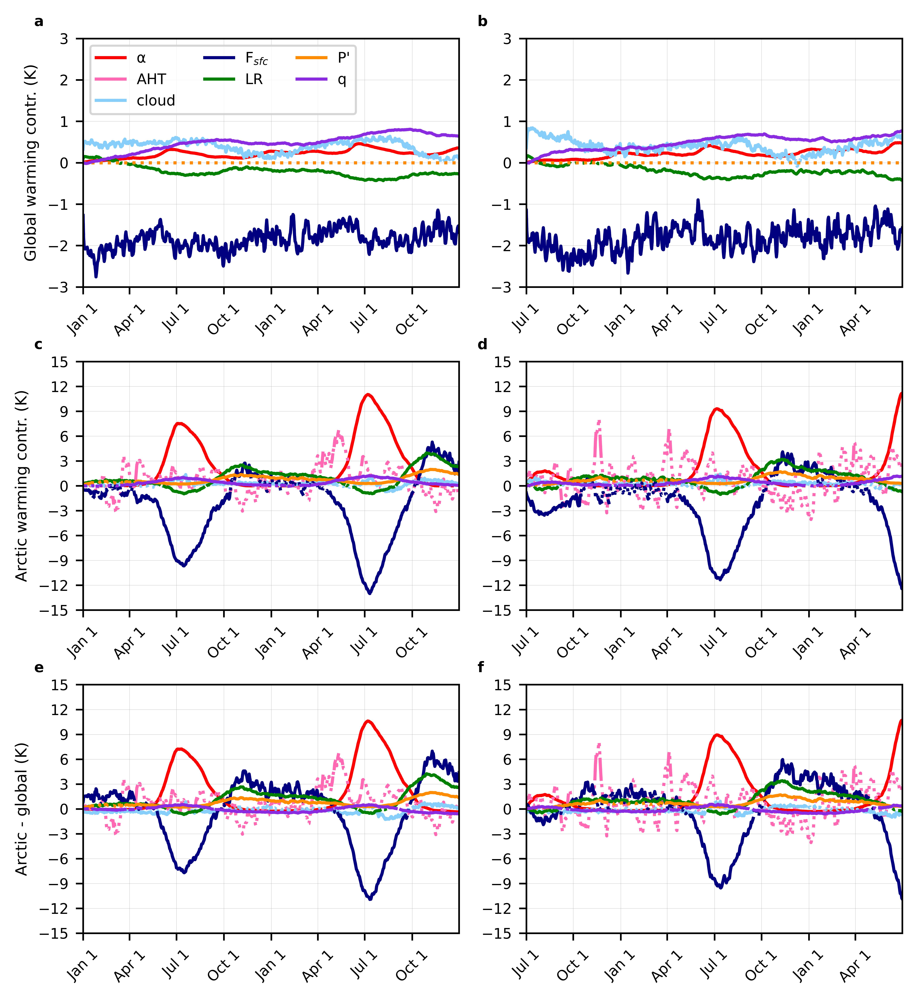

In [54]:
fig, axes = plt.subplots(ncols=2,nrows=3,sharey='row',figsize=(6.27,6.7),dpi=1000)

for ax in axes.flatten():
    ax.grid(linewidth=0.1)
    ax.set_xlim(1,730)
    ax.tick_params(axis='x', rotation=45,labelsize=7)
    ax.tick_params(axis='both',labelsize=7)
    ax.tick_params(labelleft=True)
    
#======================GLOBAL==============================
axes[0,0].set_ylabel('Global warming contr. (K)',fontsize=7.5)
axes[0,0].plot(xs,alb_glb_jan.mean(dim='ens'),color='red',linestyle='dotted')
axes[0,0].plot(xs,alb_glb_jan.mean(dim='ens').where(get_pvals(alb_glb_jan)<0.05),
             color='red',label='α')
axes[0,0].plot(xs,AHT_glb_jan.mean(dim='ens').rolling(time=15,min_periods=1).mean(),color='hotpink',linestyle='dotted')
axes[0,0].plot(xs,AHT_glb_jan.rolling(time=15,min_periods=1).mean().mean(dim='ens').where(get_pvals(AHT_glb_jan)<0.05),
             color='hotpink',label='AHT')
axes[0,0].plot(xs,cloud_glb_jan.mean(dim='ens'),color='lightskyblue',linestyle='dotted')
axes[0,0].plot(xs,cloud_glb_jan.mean(dim='ens').where(get_pvals(cloud_glb_jan)<0.05),
             color='lightskyblue',label='cloud')
axes[0,0].plot(xs,Fsfc_glb_jan.mean(dim='ens'),color='navy',linestyle='dotted')
axes[0,0].plot(xs,Fsfc_glb_jan.mean(dim='ens').where(get_pvals(Fsfc_glb_jan)<0.05),
             color='navy',label=r'F$_{sfc}$')
axes[0,0].plot(xs,lapse_glb_jan.mean(dim='ens'),color='green',linestyle='dotted')
axes[0,0].plot(xs,lapse_glb_jan.mean(dim='ens').where(get_pvals(lapse_glb_jan)<0.05),
             color='green',label='LR')
axes[0,0].plot(xs,planck_glb_jan.mean(dim='ens'),color='darkorange',linestyle='dotted')
axes[0,0].plot(xs,planck_glb_jan.mean(dim='ens').where(get_pvals(planck_glb_jan)<0.05),
             color='darkorange',label='P\'')
axes[0,0].plot(xs,q_glb_jan.mean(dim='ens'),color='blueviolet',linestyle='dotted')
axes[0,0].plot(xs,q_glb_jan.mean(dim='ens').where(get_pvals(q_glb_jan)<0.05),
             color='blueviolet',label='q')
axes[0,0].set_xticks(x_vals_jan)
axes[0,0].set_xticklabels(x_labs_jan)

axes[0,1].plot(xs,alb_glb_jul.mean(dim='ens'),color='red',linestyle='dotted')
axes[0,1].plot(xs,alb_glb_jul.mean(dim='ens').where(get_pvals(alb_glb_jul)<0.05),
             color='red',label='α')
axes[0,1].plot(xs,AHT_glb_jul.mean(dim='ens').rolling(time=15,min_periods=1).mean(),color='hotpink',linestyle='dotted')
axes[0,1].plot(xs,AHT_glb_jul.rolling(time=15,min_periods=1).mean().mean(dim='ens').where(get_pvals(AHT_glb_jul)<0.05),
             color='hotpink',label='AHT')
axes[0,1].plot(xs,cloud_glb_jul.mean(dim='ens'),color='lightskyblue',linestyle='dotted')
axes[0,1].plot(xs,cloud_glb_jul.mean(dim='ens').where(get_pvals(cloud_glb_jul)<0.05),
             color='lightskyblue',label='cloud')
axes[0,1].plot(xs,Fsfc_glb_jul.mean(dim='ens'),color='navy',linestyle='dotted')
axes[0,1].plot(xs,Fsfc_glb_jul.mean(dim='ens').where(get_pvals(Fsfc_glb_jul)<0.05),
             color='navy',label=r'F$_{sfc}$')
axes[0,1].plot(xs,lapse_glb_jul.mean(dim='ens'),color='green',linestyle='dotted')
axes[0,1].plot(xs,lapse_glb_jul.mean(dim='ens').where(get_pvals(lapse_glb_jul)<0.05),
             color='green',label='LR')
axes[0,1].plot(xs,planck_glb_jul.mean(dim='ens'),color='darkorange',linestyle='dotted')
axes[0,1].plot(xs,planck_glb_jul.mean(dim='ens').where(get_pvals(planck_glb_jul)<0.05),
             color='darkorange',label='P\'')
axes[0,1].plot(xs,q_glb_jul.mean(dim='ens'),color='blueviolet',linestyle='dotted')
axes[0,1].plot(xs,q_glb_jul.mean(dim='ens').where(get_pvals(q_glb_jul)<0.05),
             color='blueviolet',label='q')
axes[0,1].set_xticks(x_vals_jul)
axes[0,1].set_xticklabels(x_labs_jul)
axes[0,1].set_ylim(-3,3)
axes[0,1].set_yticks(np.arange(-3,4,1))

#======================ARCTIC==============================

# create figure object

axes[1,0].set_ylabel('Arctic warming contr. (K)',fontsize=7.5)
axes[1,0].plot(xs,alb_arc_jan.mean(dim='ens'),color='red',linestyle='dotted')
axes[1,0].plot(xs,alb_arc_jan.mean(dim='ens').where(get_pvals(alb_arc_jan)<0.05),
             color='red',label='α')
axes[1,0].plot(xs,AHT_arc_jan.mean(dim='ens').rolling(time=15,min_periods=1).mean(),color='hotpink',linestyle='dotted')
axes[1,0].plot(xs,AHT_arc_jan.rolling(time=15,min_periods=1).mean().mean(dim='ens').where(get_pvals(AHT_arc_jan)<0.05),
             color='hotpink',label='AHT')
axes[1,0].plot(xs,cloud_arc_jan.mean(dim='ens'),color='lightskyblue',linestyle='dotted')
axes[1,0].plot(xs,cloud_arc_jan.mean(dim='ens').where(get_pvals(cloud_arc_jan)<0.05),
             color='lightskyblue',label='cloud')
axes[1,0].plot(xs,Fsfc_arc_jan.mean(dim='ens'),color='navy',linestyle='dotted')
axes[1,0].plot(xs,Fsfc_arc_jan.mean(dim='ens').where(get_pvals(Fsfc_arc_jan)<0.05),
             color='navy',label=r'F$_{sfc}$')
axes[1,0].plot(xs,lapse_arc_jan.mean(dim='ens'),color='green',linestyle='dotted')
axes[1,0].plot(xs,lapse_arc_jan.mean(dim='ens').where(get_pvals(lapse_arc_jan)<0.05),
             color='green',label='LR')
axes[1,0].plot(xs,planck_arc_jan.mean(dim='ens'),color='darkorange',linestyle='dotted')
axes[1,0].plot(xs,planck_arc_jan.mean(dim='ens').where(get_pvals(planck_arc_jan)<0.05),
             color='darkorange',label='P\'')
axes[1,0].plot(xs,q_arc_jan.mean(dim='ens'),color='blueviolet',linestyle='dotted')
axes[1,0].plot(xs,q_arc_jan.mean(dim='ens').where(get_pvals(q_arc_jan)<0.05),
             color='blueviolet',label='q')
axes[1,0].set_xticks(x_vals_jan)
axes[1,0].set_xticklabels(x_labs_jan)

axes[1,1].plot(xs,alb_arc_jul.mean(dim='ens'),color='red',linestyle='dotted')
axes[1,1].plot(xs,alb_arc_jul.mean(dim='ens').where(get_pvals(alb_arc_jul)<0.05),
             color='red',label='α')
axes[1,1].plot(xs,AHT_arc_jul.mean(dim='ens').rolling(time=15,min_periods=1).mean(),color='hotpink',linestyle='dotted')
axes[1,1].plot(xs,AHT_arc_jul.rolling(time=15,min_periods=1).mean().mean(dim='ens').where(get_pvals(AHT_arc_jul)<0.05),
             color='hotpink',label='AHT')
axes[1,1].plot(xs,cloud_arc_jul.mean(dim='ens'),color='lightskyblue',linestyle='dotted')
axes[1,1].plot(xs,cloud_arc_jul.mean(dim='ens').where(get_pvals(cloud_arc_jul)<0.05),
             color='lightskyblue',label='cloud')
axes[1,1].plot(xs,Fsfc_arc_jul.mean(dim='ens'),color='navy',linestyle='dotted')
axes[1,1].plot(xs,Fsfc_arc_jul.mean(dim='ens').where(get_pvals(Fsfc_arc_jul)<0.05),
             color='navy',label=r'F$_{sfc}$')
axes[1,1].plot(xs,lapse_arc_jul.mean(dim='ens'),color='green',linestyle='dotted')
axes[1,1].plot(xs,lapse_arc_jul.mean(dim='ens').where(get_pvals(lapse_arc_jul)<0.05),
             color='green',label='LR')
axes[1,1].plot(xs,planck_arc_jul.mean(dim='ens'),color='darkorange',linestyle='dotted')
axes[1,1].plot(xs,planck_arc_jul.mean(dim='ens').where(get_pvals(planck_arc_jul)<0.05),
             color='darkorange',label='P\'')
axes[1,1].plot(xs,q_arc_jul.mean(dim='ens'),color='blueviolet',linestyle='dotted')
axes[1,1].plot(xs,q_arc_jul.mean(dim='ens').where(get_pvals(q_arc_jul)<0.05),
             color='blueviolet',label='q')
axes[1,1].set_xticks(x_vals_jul)
axes[1,1].set_xticklabels(x_labs_jul)
axes[1,1].set_ylim(-15,15)
axes[1,1].set_yticks(np.arange(-15,16,3))

#======================DIFF==============================

axes[2,0].set_ylabel('Arctic - global (K)',fontsize=7.5)
axes[2,0].plot(xs,alb_diff_jan.mean(dim='ens'),color='red',linestyle='dotted')
axes[2,0].plot(xs,alb_diff_jan.mean(dim='ens').where(get_pvals(alb_diff_jan)<0.05),
             color='red',label='α')
axes[2,0].plot(xs,AHT_diff_jan.mean(dim='ens').rolling(time=15,min_periods=1).mean(),color='hotpink',linestyle='dotted')
axes[2,0].plot(xs,AHT_diff_jan.rolling(time=15,min_periods=1).mean().mean(dim='ens').where(get_pvals(AHT_diff_jan)<0.05),
             color='hotpink',label='AHT')
axes[2,0].plot(xs,cloud_diff_jan.mean(dim='ens'),color='lightskyblue',linestyle='dotted')
axes[2,0].plot(xs,cloud_diff_jan.mean(dim='ens').where(get_pvals(cloud_diff_jan)<0.05),
             color='lightskyblue',label='cloud')
axes[2,0].plot(xs,Fsfc_diff_jan.mean(dim='ens'),color='navy',linestyle='dotted')
axes[2,0].plot(xs,Fsfc_diff_jan.mean(dim='ens').where(get_pvals(Fsfc_diff_jan)<0.05),
             color='navy',label=r'F$_{sfc}$')
axes[2,0].plot(xs,lapse_diff_jan.mean(dim='ens'),color='green',linestyle='dotted')
axes[2,0].plot(xs,lapse_diff_jan.mean(dim='ens').where(get_pvals(lapse_diff_jan)<0.05),
             color='green',label='LR')
axes[2,0].plot(xs,planck_diff_jan.mean(dim='ens'),color='darkorange',linestyle='dotted')
axes[2,0].plot(xs,planck_diff_jan.mean(dim='ens').where(get_pvals(planck_diff_jan)<0.05),
             color='darkorange',label='P\'')
axes[2,0].plot(xs,q_diff_jan.mean(dim='ens'),color='blueviolet',linestyle='dotted')
axes[2,0].plot(xs,q_diff_jan.mean(dim='ens').where(get_pvals(q_diff_jan)<0.05),
             color='blueviolet',label='q')
axes[2,0].set_xticks(x_vals_jan)
axes[2,0].set_xticklabels(x_labs_jan)

axes[2,1].plot(xs,alb_diff_jul.mean(dim='ens'),color='red',linestyle='dotted')
axes[2,1].plot(xs,alb_diff_jul.mean(dim='ens').where(get_pvals(alb_diff_jul)<0.05),
             color='red',label='α')
axes[2,1].plot(xs,AHT_diff_jul.mean(dim='ens').rolling(time=15,min_periods=1).mean(),color='hotpink',linestyle='dotted')
axes[2,1].plot(xs,AHT_diff_jul.rolling(time=15,min_periods=1).mean().mean(dim='ens').where(get_pvals(AHT_diff_jul)<0.05),
             color='hotpink',label='AHT')
axes[2,1].plot(xs,cloud_diff_jul.mean(dim='ens'),color='lightskyblue',linestyle='dotted')
axes[2,1].plot(xs,cloud_diff_jul.mean(dim='ens').where(get_pvals(cloud_diff_jul)<0.05),
             color='lightskyblue',label='cloud')
axes[2,1].plot(xs,Fsfc_diff_jul.mean(dim='ens'),color='navy',linestyle='dotted')
axes[2,1].plot(xs,Fsfc_diff_jul.mean(dim='ens').where(get_pvals(Fsfc_diff_jul)<0.05),
             color='navy',label=r'F$_{sfc}$')
axes[2,1].plot(xs,lapse_diff_jul.mean(dim='ens'),color='green',linestyle='dotted')
axes[2,1].plot(xs,lapse_diff_jul.mean(dim='ens').where(get_pvals(lapse_diff_jul)<0.05),
             color='green',label='LR')
axes[2,1].plot(xs,planck_diff_jul.mean(dim='ens'),color='darkorange',linestyle='dotted')
axes[2,1].plot(xs,planck_diff_jul.mean(dim='ens').where(get_pvals(planck_diff_jul)<0.05),
             color='darkorange',label='P\'')
axes[2,1].plot(xs,q_diff_jul.mean(dim='ens'),color='blueviolet',linestyle='dotted')
axes[2,1].plot(xs,q_diff_jul.mean(dim='ens').where(get_pvals(q_diff_jul)<0.05),
             color='blueviolet',label='q')
axes[2,1].set_xticks(x_vals_jul)
axes[2,1].set_xticklabels(x_labs_jul)
axes[0,0].legend(loc='upper left',fontsize=7,ncol=3)
axes[2,1].set_ylim(-15,15)
axes[2,1].set_yticks(np.arange(-15,16,3))

    
plt.tight_layout()
plt.subplots_adjust(hspace=0.3)

letters = ['a','b','c','d','e','f']
for i,ax in enumerate(axes.flatten()):
    ax.text(-0.13,1.05,letters[i],transform=ax.transAxes,fontsize=7,fontweight='bold')
    
plt.savefig('Fig3_feedback_time_series.jpg',dpi=1000,bbox_inches='tight')
plt.show()

### Land only

In [12]:
# january
lead = '/dx02/janoski/cesm/spat_avg_feedbacks/norm_feedbacks/land_only/b40.1850.cam5-lens.01.arc_'
AHT_arc_jan = xr.open_dataarray(lead+'AHT.nc')
alb_arc_jan = xr.open_dataarray(lead+'alb_TOA.nc')
cloud_LW_arc_jan = xr.open_dataarray(lead+'cloud_LW_TOA.nc')
cloud_SW_arc_jan = xr.open_dataarray(lead+'cloud_SW_TOA.nc')
cloud_arc_jan = cloud_LW_arc_jan + cloud_SW_arc_jan
Fsfc_arc_jan = xr.open_dataarray(lead+'Fsfc.nc')
lapse_arc_jan = xr.open_dataarray(lead+'lapse_tropo_TOA.nc')
planck_arc_jan = xr.open_dataarray(lead+'planck_tropo_TOA.nc')
q_LW_arc_jan = xr.open_dataarray(lead+'q_LW_tropo_TOA.nc')
q_SW_arc_jan = xr.open_dataarray(lead+'q_SW_tropo_TOA.nc')
q_arc_jan = q_LW_arc_jan + q_SW_arc_jan

# jul
lead = '/dx02/janoski/cesm/spat_avg_feedbacks/norm_feedbacks/land_only/b40.1850.cam5-lens.07.arc_'
AHT_arc_jul = xr.open_dataarray(lead+'AHT.nc')
alb_arc_jul = xr.open_dataarray(lead+'alb_TOA.nc')
cloud_LW_arc_jul = xr.open_dataarray(lead+'cloud_LW_TOA.nc')
cloud_SW_arc_jul = xr.open_dataarray(lead+'cloud_SW_TOA.nc')
cloud_arc_jul = cloud_LW_arc_jul + cloud_SW_arc_jul
Fsfc_arc_jul = xr.open_dataarray(lead+'Fsfc.nc')
lapse_arc_jul = xr.open_dataarray(lead+'lapse_tropo_TOA.nc')
planck_arc_jul = xr.open_dataarray(lead+'planck_tropo_TOA.nc')
q_LW_arc_jul = xr.open_dataarray(lead+'q_LW_tropo_TOA.nc')
q_SW_arc_jul = xr.open_dataarray(lead+'q_SW_tropo_TOA.nc')
q_arc_jul = q_LW_arc_jul + q_SW_arc_jul

In [13]:
# diff
AHT_diff_jan = AHT_arc_jan - AHT_glb_jan
alb_diff_jan = alb_arc_jan - alb_glb_jan
cloud_LW_diff_jan = cloud_LW_arc_jan - cloud_LW_glb_jan
cloud_SW_diff_jan = cloud_SW_arc_jan - cloud_SW_glb_jan
cloud_diff_jan = cloud_LW_diff_jan + cloud_SW_diff_jan
Fsfc_diff_jan = Fsfc_arc_jan - Fsfc_glb_jan
lapse_diff_jan = lapse_arc_jan - lapse_glb_jan
planck_diff_jan = planck_arc_jan - planck_glb_jan
q_LW_diff_jan = q_LW_arc_jan - q_LW_glb_jan
q_SW_diff_jan = q_SW_arc_jan - q_SW_glb_jan
q_diff_jan = q_LW_diff_jan + q_SW_diff_jan

AHT_diff_jul = AHT_arc_jul - AHT_glb_jul
alb_diff_jul = alb_arc_jul - alb_glb_jul
cloud_LW_diff_jul = cloud_LW_arc_jul - cloud_LW_glb_jul
cloud_SW_diff_jul = cloud_SW_arc_jul - cloud_SW_glb_jul
cloud_diff_jul = cloud_LW_diff_jul + cloud_SW_diff_jul
Fsfc_diff_jul = Fsfc_arc_jul - Fsfc_glb_jul
lapse_diff_jul = lapse_arc_jul - lapse_glb_jul
planck_diff_jul = planck_arc_jul - planck_glb_jul
q_LW_diff_jul = q_LW_arc_jul - q_LW_glb_jul
q_SW_diff_jul = q_SW_arc_jul - q_SW_glb_jul
q_diff_jul = q_LW_diff_jul + q_SW_diff_jul

In [ ]:
# create figure object
fig, axes = plt.subplots(figsize=(8,3),ncols=2,sharey=True)

axes[0].plot(xs,alb_arc_jan.mean(dim='ens'),color='red',linestyle='dotted')
axes[0].plot(xs,alb_arc_jan.mean(dim='ens').where(get_pvals(alb_arc_jan)<0.05),
             color='red',label='α')
axes[0].plot(xs,AHT_arc_jan.mean(dim='ens').rolling(time=15,min_periods=1).mean(),color='pink',linestyle='dotted')
axes[0].plot(xs,AHT_arc_jan.rolling(time=15,min_periods=1).mean().mean(dim='ens').where(get_pvals(AHT_arc_jan)<0.05),
             color='pink',label='AHT')
axes[0].plot(xs,cloud_arc_jan.mean(dim='ens'),color='lightskyblue',linestyle='dotted')
axes[0].plot(xs,cloud_arc_jan.mean(dim='ens').where(get_pvals(cloud_arc_jan)<0.05),
             color='lightskyblue',label='cloud')
axes[0].plot(xs,Fsfc_arc_jan.mean(dim='ens'),color='navy',linestyle='dotted')
axes[0].plot(xs,Fsfc_arc_jan.mean(dim='ens').where(get_pvals(Fsfc_arc_jan)<0.05),
             color='navy',label=r'F$_{sfc}$')
axes[0].plot(xs,lapse_arc_jan.mean(dim='ens'),color='green',linestyle='dotted')
axes[0].plot(xs,lapse_arc_jan.mean(dim='ens').where(get_pvals(lapse_arc_jan)<0.05),
             color='green',label='LR')
axes[0].plot(xs,planck_arc_jan.mean(dim='ens'),color='darkorange',linestyle='dotted')
axes[0].plot(xs,planck_arc_jan.mean(dim='ens').where(get_pvals(planck_arc_jan)<0.05),
             color='darkorange',label='Planck')
axes[0].plot(xs,q_arc_jan.mean(dim='ens'),color='blueviolet',linestyle='dotted')
axes[0].plot(xs,q_arc_jan.mean(dim='ens').where(get_pvals(q_arc_jan)<0.05),
             color='blueviolet',label='q')
axes[0].set_xticks(x_vals_jan)
axes[0].set_xticklabels(x_labs_jan)

axes[1].plot(xs,alb_arc_jul.mean(dim='ens'),color='red',linestyle='dotted')
axes[1].plot(xs,alb_arc_jul.mean(dim='ens').where(get_pvals(alb_arc_jul)<0.05),
             color='red',label='α')
axes[1].plot(xs,AHT_arc_jul.mean(dim='ens').rolling(time=15,min_periods=1).mean(),color='pink',linestyle='dotted')
axes[1].plot(xs,AHT_arc_jul.rolling(time=15,min_periods=1).mean().mean(dim='ens').where(get_pvals(AHT_arc_jul)<0.05),
             color='pink',label='AHT')
axes[1].plot(xs,cloud_arc_jul.mean(dim='ens'),color='lightskyblue',linestyle='dotted')
axes[1].plot(xs,cloud_arc_jul.mean(dim='ens').where(get_pvals(cloud_arc_jul)<0.05),
             color='lightskyblue',label='cloud')
axes[1].plot(xs,Fsfc_arc_jul.mean(dim='ens'),color='navy',linestyle='dotted')
axes[1].plot(xs,Fsfc_arc_jul.mean(dim='ens').where(get_pvals(Fsfc_arc_jul)<0.05),
             color='navy',label=r'F$_{sfc}$')
axes[1].plot(xs,lapse_arc_jul.mean(dim='ens'),color='green',linestyle='dotted')
axes[1].plot(xs,lapse_arc_jul.mean(dim='ens').where(get_pvals(lapse_arc_jul)<0.05),
             color='green',label='LR')
axes[1].plot(xs,planck_arc_jul.mean(dim='ens'),color='darkorange',linestyle='dotted')
axes[1].plot(xs,planck_arc_jul.mean(dim='ens').where(get_pvals(planck_arc_jul)<0.05),
             color='darkorange',label='Planck')
axes[1].plot(xs,q_arc_jul.mean(dim='ens'),color='blueviolet',linestyle='dotted')
axes[1].plot(xs,q_arc_jul.mean(dim='ens').where(get_pvals(q_arc_jul)<0.05),
             color='blueviolet',label='q')
axes[1].set_xticks(x_vals_jul)
axes[1].set_xticklabels(x_labs_jul)
axes[1].legend(fontsize=7,ncol=2)

for ax in axes:
    ax.set_xlim([1,731])
    ax.set_ylim([-17.5,17.5])
    ax.set_yticks(np.arange(-15,16,3))
    ax.tick_params(axis='x', rotation=45,labelsize=8)
    ax.tick_params(axis='y',labelsize=8)
    ax.grid()
    ax.hlines(0,1,731,color='black',linestyle=':')

axes[0].set_ylabel(r'Temp contr. (K), Arctic land',fontsize=8)

# plt.title('Global feedback temp contributions',fontsize=10)
plt.tight_layout()
plt.show()

In [ ]:
# create figure object
fig, axes = plt.subplots(figsize=(8,3),ncols=2,sharey=True)

axes[0].plot(xs,alb_diff_jan.mean(dim='ens'),color='red',linestyle='dotted')
axes[0].plot(xs,alb_diff_jan.mean(dim='ens').where(get_pvals(alb_diff_jan)<0.05),
             color='red',label='α')
axes[0].plot(xs,AHT_diff_jan.mean(dim='ens').rolling(time=15,min_periods=1).mean(),color='pink',linestyle='dotted')
axes[0].plot(xs,AHT_diff_jan.rolling(time=15,min_periods=1).mean().mean(dim='ens').where(get_pvals(AHT_diff_jan)<0.05),
             color='pink',label='AHT')
axes[0].plot(xs,cloud_diff_jan.mean(dim='ens'),color='lightskyblue',linestyle='dotted')
axes[0].plot(xs,cloud_diff_jan.mean(dim='ens').where(get_pvals(cloud_diff_jan)<0.05),
             color='lightskyblue',label='cloud')
axes[0].plot(xs,Fsfc_diff_jan.mean(dim='ens'),color='navy',linestyle='dotted')
axes[0].plot(xs,Fsfc_diff_jan.mean(dim='ens').where(get_pvals(Fsfc_diff_jan)<0.05),
             color='navy',label=r'F$_{sfc}$')
axes[0].plot(xs,lapse_diff_jan.mean(dim='ens'),color='green',linestyle='dotted')
axes[0].plot(xs,lapse_diff_jan.mean(dim='ens').where(get_pvals(lapse_diff_jan)<0.05),
             color='green',label='LR')
axes[0].plot(xs,planck_diff_jan.mean(dim='ens'),color='darkorange',linestyle='dotted')
axes[0].plot(xs,planck_diff_jan.mean(dim='ens').where(get_pvals(planck_diff_jan)<0.05),
             color='darkorange',label='Planck')
axes[0].plot(xs,q_diff_jan.mean(dim='ens'),color='blueviolet',linestyle='dotted')
axes[0].plot(xs,q_diff_jan.mean(dim='ens').where(get_pvals(q_diff_jan)<0.05),
             color='blueviolet',label='q')
axes[0].set_xticks(x_vals_jan)
axes[0].set_xticklabels(x_labs_jan)

axes[1].plot(xs,alb_diff_jul.mean(dim='ens'),color='red',linestyle='dotted')
axes[1].plot(xs,alb_diff_jul.mean(dim='ens').where(get_pvals(alb_diff_jul)<0.05),
             color='red',label='α')
axes[1].plot(xs,AHT_diff_jul.mean(dim='ens').rolling(time=15,min_periods=1).mean(),color='pink',linestyle='dotted')
axes[1].plot(xs,AHT_diff_jul.rolling(time=15,min_periods=1).mean().mean(dim='ens').where(get_pvals(AHT_diff_jul)<0.05),
             color='pink',label='AHT')
axes[1].plot(xs,cloud_diff_jul.mean(dim='ens'),color='lightskyblue',linestyle='dotted')
axes[1].plot(xs,cloud_diff_jul.mean(dim='ens').where(get_pvals(cloud_diff_jul)<0.05),
             color='lightskyblue',label='cloud')
axes[1].plot(xs,Fsfc_diff_jul.mean(dim='ens'),color='navy',linestyle='dotted')
axes[1].plot(xs,Fsfc_diff_jul.mean(dim='ens').where(get_pvals(Fsfc_diff_jul)<0.05),
             color='navy',label=r'F$_{sfc}$')
axes[1].plot(xs,lapse_diff_jul.mean(dim='ens'),color='green',linestyle='dotted')
axes[1].plot(xs,lapse_diff_jul.mean(dim='ens').where(get_pvals(lapse_diff_jul)<0.05),
             color='green',label='LR')
axes[1].plot(xs,planck_diff_jul.mean(dim='ens'),color='darkorange',linestyle='dotted')
axes[1].plot(xs,planck_diff_jul.mean(dim='ens').where(get_pvals(planck_diff_jul)<0.05),
             color='darkorange',label='Planck')
axes[1].plot(xs,q_diff_jul.mean(dim='ens'),color='blueviolet',linestyle='dotted')
axes[1].plot(xs,q_diff_jul.mean(dim='ens').where(get_pvals(q_diff_jul)<0.05),
             color='blueviolet',label='q')
axes[1].set_xticks(x_vals_jul)
axes[1].set_xticklabels(x_labs_jul)
axes[1].legend(fontsize=7,ncol=2)

for ax in axes:
    ax.set_xlim([1,731])
    ax.set_ylim([-15,15])
    ax.set_yticks(np.arange(-15,16,3))
    ax.tick_params(axis='x', rotation=45,labelsize=8)
    ax.tick_params(axis='y',labelsize=8)
    ax.grid()
    ax.hlines(0,1,731,color='black',linestyle=':')

axes[0].set_ylabel(r'Temp contr. (K), Arc land - glb',fontsize=8)

# plt.title('Global feedback temp contributions',fontsize=10)
plt.tight_layout()
plt.show()

### Ocean only

In [ ]:
# january
lead = '/dx02/janoski/cesm/spat_avg_feedbacks/norm_feedbacks/ocean_only/b40.1850.cam5-lens.01.arc_'
AHT_arc_jan = xr.open_dataarray(lead+'AHT.nc')
alb_arc_jan = xr.open_dataarray(lead+'alb_TOA.nc')
cloud_LW_arc_jan = xr.open_dataarray(lead+'cloud_LW_TOA.nc')
cloud_SW_arc_jan = xr.open_dataarray(lead+'cloud_SW_TOA.nc')
cloud_arc_jan = cloud_LW_arc_jan + cloud_SW_arc_jan
Fsfc_arc_jan = xr.open_dataarray(lead+'Fsfc.nc')
lapse_arc_jan = xr.open_dataarray(lead+'lapse_tropo_TOA.nc')
planck_arc_jan = xr.open_dataarray(lead+'planck_tropo_TOA.nc')
q_LW_arc_jan = xr.open_dataarray(lead+'q_LW_tropo_TOA.nc')
q_SW_arc_jan = xr.open_dataarray(lead+'q_SW_tropo_TOA.nc')
q_arc_jan = q_LW_arc_jan + q_SW_arc_jan

# jul
lead = '/dx02/janoski/cesm/spat_avg_feedbacks/norm_feedbacks/ocean_only/b40.1850.cam5-lens.07.arc_'
AHT_arc_jul = xr.open_dataarray(lead+'AHT.nc')
alb_arc_jul = xr.open_dataarray(lead+'alb_TOA.nc')
cloud_LW_arc_jul = xr.open_dataarray(lead+'cloud_LW_TOA.nc')
cloud_SW_arc_jul = xr.open_dataarray(lead+'cloud_SW_TOA.nc')
cloud_arc_jul = cloud_LW_arc_jul + cloud_SW_arc_jul
Fsfc_arc_jul = xr.open_dataarray(lead+'Fsfc.nc')
lapse_arc_jul = xr.open_dataarray(lead+'lapse_tropo_TOA.nc')
planck_arc_jul = xr.open_dataarray(lead+'planck_tropo_TOA.nc')
q_LW_arc_jul = xr.open_dataarray(lead+'q_LW_tropo_TOA.nc')
q_SW_arc_jul = xr.open_dataarray(lead+'q_SW_tropo_TOA.nc')
q_arc_jul = q_LW_arc_jul + q_SW_arc_jul

In [ ]:
# diff
AHT_diff_jan = AHT_arc_jan - AHT_glb_jan
alb_diff_jan = alb_arc_jan - alb_glb_jan
cloud_LW_diff_jan = cloud_LW_arc_jan - cloud_LW_glb_jan
cloud_SW_diff_jan = cloud_SW_arc_jan - cloud_SW_glb_jan
cloud_diff_jan = cloud_LW_diff_jan + cloud_SW_diff_jan
Fsfc_diff_jan = Fsfc_arc_jan - Fsfc_glb_jan
lapse_diff_jan = lapse_arc_jan - lapse_glb_jan
planck_diff_jan = planck_arc_jan - planck_glb_jan
q_LW_diff_jan = q_LW_arc_jan - q_LW_glb_jan
q_SW_diff_jan = q_SW_arc_jan - q_SW_glb_jan
q_diff_jan = q_LW_diff_jan + q_SW_diff_jan

AHT_diff_jul = AHT_arc_jul - AHT_glb_jul
alb_diff_jul = alb_arc_jul - alb_glb_jul
cloud_LW_diff_jul = cloud_LW_arc_jul - cloud_LW_glb_jul
cloud_SW_diff_jul = cloud_SW_arc_jul - cloud_SW_glb_jul
cloud_diff_jul = cloud_LW_diff_jul + cloud_SW_diff_jul
Fsfc_diff_jul = Fsfc_arc_jul - Fsfc_glb_jul
lapse_diff_jul = lapse_arc_jul - lapse_glb_jul
planck_diff_jul = planck_arc_jul - planck_glb_jul
q_LW_diff_jul = q_LW_arc_jul - q_LW_glb_jul
q_SW_diff_jul = q_SW_arc_jul - q_SW_glb_jul
q_diff_jul = q_LW_diff_jul + q_SW_diff_jul

In [ ]:
# create figure object
fig, axes = plt.subplots(figsize=(8,3),ncols=2,sharey=True)

axes[0].plot(xs,alb_arc_jan.mean(dim='ens'),color='red',linestyle='dotted')
axes[0].plot(xs,alb_arc_jan.mean(dim='ens').where(get_pvals(alb_arc_jan)<0.05),
             color='red',label='α')
axes[0].plot(xs,AHT_arc_jan.mean(dim='ens').rolling(time=15,min_periods=1).mean(),color='pink',linestyle='dotted')
axes[0].plot(xs,AHT_arc_jan.rolling(time=15,min_periods=1).mean().mean(dim='ens').where(get_pvals(AHT_arc_jan)<0.05),
             color='pink',label='AHT')
axes[0].plot(xs,cloud_arc_jan.mean(dim='ens'),color='lightskyblue',linestyle='dotted')
axes[0].plot(xs,cloud_arc_jan.mean(dim='ens').where(get_pvals(cloud_arc_jan)<0.05),
             color='lightskyblue',label='cloud')
axes[0].plot(xs,Fsfc_arc_jan.mean(dim='ens'),color='navy',linestyle='dotted')
axes[0].plot(xs,Fsfc_arc_jan.mean(dim='ens').where(get_pvals(Fsfc_arc_jan)<0.05),
             color='navy',label=r'F$_{sfc}$')
axes[0].plot(xs,lapse_arc_jan.mean(dim='ens'),color='green',linestyle='dotted')
axes[0].plot(xs,lapse_arc_jan.mean(dim='ens').where(get_pvals(lapse_arc_jan)<0.05),
             color='green',label='LR')
axes[0].plot(xs,planck_arc_jan.mean(dim='ens'),color='darkorange',linestyle='dotted')
axes[0].plot(xs,planck_arc_jan.mean(dim='ens').where(get_pvals(planck_arc_jan)<0.05),
             color='darkorange',label='Planck')
axes[0].plot(xs,q_arc_jan.mean(dim='ens'),color='blueviolet',linestyle='dotted')
axes[0].plot(xs,q_arc_jan.mean(dim='ens').where(get_pvals(q_arc_jan)<0.05),
             color='blueviolet',label='q')
axes[0].set_xticks(x_vals_jan)
axes[0].set_xticklabels(x_labs_jan)

axes[1].plot(xs,alb_arc_jul.mean(dim='ens'),color='red',linestyle='dotted')
axes[1].plot(xs,alb_arc_jul.mean(dim='ens').where(get_pvals(alb_arc_jul)<0.05),
             color='red',label='α')
axes[1].plot(xs,AHT_arc_jul.mean(dim='ens').rolling(time=15,min_periods=1).mean(),color='pink',linestyle='dotted')
axes[1].plot(xs,AHT_arc_jul.rolling(time=15,min_periods=1).mean().mean(dim='ens').where(get_pvals(AHT_arc_jul)<0.05),
             color='pink',label='AHT')
axes[1].plot(xs,cloud_arc_jul.mean(dim='ens'),color='lightskyblue',linestyle='dotted')
axes[1].plot(xs,cloud_arc_jul.mean(dim='ens').where(get_pvals(cloud_arc_jul)<0.05),
             color='lightskyblue',label='cloud')
axes[1].plot(xs,Fsfc_arc_jul.mean(dim='ens'),color='navy',linestyle='dotted')
axes[1].plot(xs,Fsfc_arc_jul.mean(dim='ens').where(get_pvals(Fsfc_arc_jul)<0.05),
             color='navy',label=r'F$_{sfc}$')
axes[1].plot(xs,lapse_arc_jul.mean(dim='ens'),color='green',linestyle='dotted')
axes[1].plot(xs,lapse_arc_jul.mean(dim='ens').where(get_pvals(lapse_arc_jul)<0.05),
             color='green',label='LR')
axes[1].plot(xs,planck_arc_jul.mean(dim='ens'),color='darkorange',linestyle='dotted')
axes[1].plot(xs,planck_arc_jul.mean(dim='ens').where(get_pvals(planck_arc_jul)<0.05),
             color='darkorange',label='Planck')
axes[1].plot(xs,q_arc_jul.mean(dim='ens'),color='blueviolet',linestyle='dotted')
axes[1].plot(xs,q_arc_jul.mean(dim='ens').where(get_pvals(q_arc_jul)<0.05),
             color='blueviolet',label='q')
axes[1].set_xticks(x_vals_jul)
axes[1].set_xticklabels(x_labs_jul)
axes[1].legend(fontsize=7,ncol=2)

for ax in axes:
    ax.set_xlim([1,731])
    ax.set_ylim([-17.5,17.5])
    ax.set_yticks(np.arange(-15,16,3))
    ax.tick_params(axis='x', rotation=45,labelsize=8)
    ax.tick_params(axis='y',labelsize=8)
    ax.grid()
    ax.hlines(0,1,731,color='black',linestyle=':')

axes[0].set_ylabel(r'Temp contr. (K), Arctic ocean',fontsize=8)

# plt.title('Global feedback temp contributions',fontsize=10)
plt.tight_layout()
plt.show()

In [ ]:
# create figure object
fig, axes = plt.subplots(figsize=(8,3),ncols=2,sharey=True)

axes[0].plot(xs,alb_diff_jan.mean(dim='ens'),color='red',linestyle='dotted')
axes[0].plot(xs,alb_diff_jan.mean(dim='ens').where(get_pvals(alb_diff_jan)<0.05),
             color='red',label='α')
axes[0].plot(xs,AHT_diff_jan.mean(dim='ens').rolling(time=15,min_periods=1).mean(),color='pink',linestyle='dotted')
axes[0].plot(xs,AHT_diff_jan.rolling(time=15,min_periods=1).mean().mean(dim='ens').where(get_pvals(AHT_diff_jan)<0.05),
             color='pink',label='AHT')
axes[0].plot(xs,cloud_diff_jan.mean(dim='ens'),color='lightskyblue',linestyle='dotted')
axes[0].plot(xs,cloud_diff_jan.mean(dim='ens').where(get_pvals(cloud_diff_jan)<0.05),
             color='lightskyblue',label='cloud')
axes[0].plot(xs,Fsfc_diff_jan.mean(dim='ens'),color='navy',linestyle='dotted')
axes[0].plot(xs,Fsfc_diff_jan.mean(dim='ens').where(get_pvals(Fsfc_diff_jan)<0.05),
             color='navy',label=r'F$_{sfc}$')
axes[0].plot(xs,lapse_diff_jan.mean(dim='ens'),color='green',linestyle='dotted')
axes[0].plot(xs,lapse_diff_jan.mean(dim='ens').where(get_pvals(lapse_diff_jan)<0.05),
             color='green',label='LR')
axes[0].plot(xs,planck_diff_jan.mean(dim='ens'),color='darkorange',linestyle='dotted')
axes[0].plot(xs,planck_diff_jan.mean(dim='ens').where(get_pvals(planck_diff_jan)<0.05),
             color='darkorange',label='Planck')
axes[0].plot(xs,q_diff_jan.mean(dim='ens'),color='blueviolet',linestyle='dotted')
axes[0].plot(xs,q_diff_jan.mean(dim='ens').where(get_pvals(q_diff_jan)<0.05),
             color='blueviolet',label='q')
axes[0].set_xticks(x_vals_jan)
axes[0].set_xticklabels(x_labs_jan)

axes[1].plot(xs,alb_diff_jul.mean(dim='ens'),color='red',linestyle='dotted')
axes[1].plot(xs,alb_diff_jul.mean(dim='ens').where(get_pvals(alb_diff_jul)<0.05),
             color='red',label='α')
axes[1].plot(xs,AHT_diff_jul.mean(dim='ens').rolling(time=15,min_periods=1).mean(),color='pink',linestyle='dotted')
axes[1].plot(xs,AHT_diff_jul.rolling(time=15,min_periods=1).mean().mean(dim='ens').where(get_pvals(AHT_diff_jul)<0.05),
             color='pink',label='AHT')
axes[1].plot(xs,cloud_diff_jul.mean(dim='ens'),color='lightskyblue',linestyle='dotted')
axes[1].plot(xs,cloud_diff_jul.mean(dim='ens').where(get_pvals(cloud_diff_jul)<0.05),
             color='lightskyblue',label='cloud')
axes[1].plot(xs,Fsfc_diff_jul.mean(dim='ens'),color='navy',linestyle='dotted')
axes[1].plot(xs,Fsfc_diff_jul.mean(dim='ens').where(get_pvals(Fsfc_diff_jul)<0.05),
             color='navy',label=r'F$_{sfc}$')
axes[1].plot(xs,lapse_diff_jul.mean(dim='ens'),color='green',linestyle='dotted')
axes[1].plot(xs,lapse_diff_jul.mean(dim='ens').where(get_pvals(lapse_diff_jul)<0.05),
             color='green',label='LR')
axes[1].plot(xs,planck_diff_jul.mean(dim='ens'),color='darkorange',linestyle='dotted')
axes[1].plot(xs,planck_diff_jul.mean(dim='ens').where(get_pvals(planck_diff_jul)<0.05),
             color='darkorange',label='Planck')
axes[1].plot(xs,q_diff_jul.mean(dim='ens'),color='blueviolet',linestyle='dotted')
axes[1].plot(xs,q_diff_jul.mean(dim='ens').where(get_pvals(q_diff_jul)<0.05),
             color='blueviolet',label='q')
axes[1].set_xticks(x_vals_jul)
axes[1].set_xticklabels(x_labs_jul)
axes[1].legend(fontsize=7,ncol=2)

for ax in axes:
    ax.set_xlim([1,731])
    ax.set_ylim([-15,15])
    ax.set_yticks(np.arange(-15,16,3))
    ax.tick_params(axis='x', rotation=45,labelsize=8)
    ax.tick_params(axis='y',labelsize=8)
    ax.grid()
    ax.hlines(0,1,731,color='black',linestyle=':')

axes[0].set_ylabel(r'Temp contr. (K), Arc ocean - glb',fontsize=8)

# plt.title('Global feedback temp contributions',fontsize=10)
plt.tight_layout()
plt.show()

## Atmospheric Heat Convergence

In [55]:
# january
lead = '/dx02/janoski/cesm/spat_avg_feedbacks/all/b40.1850.cam5-lens.01.arc_'
AHT_arc_jan = xr.open_dataarray(lead+'AHT_expl.nc')
Sconv_arc_jan = xr.open_dataarray(lead+'Sconv_expl.nc')
Wconv_arc_jan = xr.open_dataarray(lead+'Wconv_expl.nc')

# july
lead = '/dx02/janoski/cesm/spat_avg_feedbacks/all/b40.1850.cam5-lens.07.arc_'
AHT_arc_jul = xr.open_dataarray(lead+'AHT_expl.nc')
Sconv_arc_jul = xr.open_dataarray(lead+'Sconv_expl.nc')
Wconv_arc_jul = xr.open_dataarray(lead+'Wconv_expl.nc')

# Get some variables for relabeling the x-axes
first_days_jan = np.array([1,91,182,274])

x_vals_jan = np.concatenate((first_days_jan,first_days_jan+365))
x_labs_jan = np.tile(['Jan 1','Apr 1','Jul 1','Oct 1'],
                 (2))

first_days_jul = np.array([1,92,184,274])
x_vals_jul = np.concatenate((first_days_jul,first_days_jul+365))
x_labs_jul = np.tile(['Jul 1','Oct 1','Jan 1','Apr 1'],
                 (2))

xs=np.arange(1,731,1)

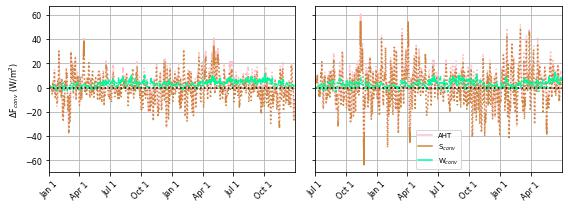

In [56]:
# create figure object
fig, axes = plt.subplots(figsize=(8,3),ncols=2,sharey=True)

axes[0].plot(xs,AHT_arc_jan.mean(dim='ens'),color='pink',linestyle='dotted')
axes[0].plot(xs,AHT_arc_jan.mean(dim='ens').where(get_pvals(AHT_arc_jan)<0.05),
             color='pink',label='Total')
# axes[0].plot(xs,Sconv_diff_jan.mean(dim='ens').rolling(time=15,min_periods=1).mean(),color='pink',linestyle='dotted')
axes[0].plot(xs,Sconv_arc_jan.mean(dim='ens'),color='peru',linestyle='dotted')
axes[0].plot(xs,Sconv_arc_jan.mean(dim='ens').where(get_pvals(Sconv_arc_jan)<0.05),
             color='peru',label=r'S$_{conv}$')
axes[0].plot(xs,Wconv_arc_jan.mean(dim='ens'),color='mediumspringgreen',linestyle='dotted')
axes[0].plot(xs,Wconv_arc_jan.mean(dim='ens').where(get_pvals(Wconv_arc_jan)<0.05),
             color='mediumspringgreen',label=r'W$_{conv}$')
axes[0].set_xticks(x_vals_jan)
axes[0].set_xticklabels(x_labs_jan)

axes[1].plot(xs,AHT_arc_jul.mean(dim='ens'),color='pink',linestyle='dotted')
axes[1].plot(xs,AHT_arc_jul.mean(dim='ens').where(get_pvals(AHT_arc_jul)<0.05),
             color='pink',label='AHT')
axes[1].plot(xs,Sconv_arc_jul.mean(dim='ens'),color='peru',linestyle='dotted')
axes[1].plot(xs,Sconv_arc_jul.mean(dim='ens').where(get_pvals(Sconv_arc_jul)<0.05),
             color='peru',label=r'S$_{conv}$')
axes[1].plot(xs,Wconv_arc_jul.mean(dim='ens'),color='mediumspringgreen',linestyle='dotted')
axes[1].plot(xs,Wconv_arc_jul.mean(dim='ens').where(get_pvals(Wconv_arc_jul)<0.05),
             color='mediumspringgreen',label=r'W$_{conv}$')
axes[1].set_xticks(x_vals_jul)
axes[1].set_xticklabels(x_labs_jul)

axes[1].legend(fontsize=7)

for ax in axes:
    ax.set_xlim([1,731])
    # ax.set_ylim([-60,60])
    # ax.set_yticks(np.arange(-15,16,3))
    ax.tick_params(axis='x', rotation=45,labelsize=8)
    ax.tick_params(axis='y',labelsize=8)
    ax.grid()
    ax.hlines(0,1,731,color='black',linestyle=':')

axes[0].set_ylabel(r'ΔF$_{conv}$ (W/m$^{2}$)',fontsize=8)

# plt.title('Global feedback temp contributions',fontsize=10)
plt.tight_layout()
plt.show()

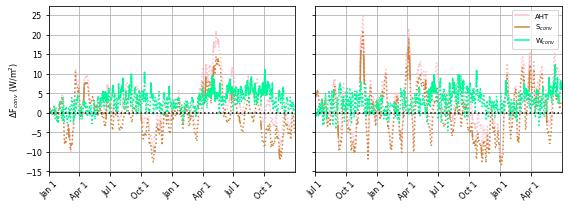

In [57]:
# create figure object
fig, axes = plt.subplots(figsize=(8,3),ncols=2,sharey=True)

axes[0].plot(xs,AHT_arc_jan.mean(dim='ens').rolling(time=15,min_periods=1).mean(),color='pink',linestyle='dotted')
axes[0].plot(xs,AHT_arc_jan.mean(dim='ens').rolling(time=15,min_periods=1).mean().where(get_pvals(AHT_arc_jan)<0.05),
             color='pink',label='Total')
# axes[0].plot(xs,Sconv_diff_jan.mean(dim='ens').rolling(time=15,min_periods=1).mean(),color='pink',linestyle='dotted')
axes[0].plot(xs,Sconv_arc_jan.mean(dim='ens').rolling(time=15,min_periods=1).mean(),color='peru',linestyle='dotted')
axes[0].plot(xs,Sconv_arc_jan.mean(dim='ens').rolling(time=15,min_periods=1).mean().where(get_pvals(Sconv_arc_jan)<0.05),
             color='peru',label=r'S$_{conv}$')
axes[0].plot(xs,Wconv_arc_jan.mean(dim='ens'),color='mediumspringgreen',linestyle='dotted')
axes[0].plot(xs,Wconv_arc_jan.mean(dim='ens').where(get_pvals(Wconv_arc_jan)<0.05),
             color='mediumspringgreen',label=r'W$_{conv}$')
axes[0].set_xticks(x_vals_jan)
axes[0].set_xticklabels(x_labs_jan)

axes[1].plot(xs,AHT_arc_jul.mean(dim='ens').rolling(time=15,min_periods=1).mean(),color='pink',linestyle='dotted')
axes[1].plot(xs,AHT_arc_jul.mean(dim='ens').rolling(time=15,min_periods=1).mean().where(get_pvals(AHT_arc_jul)<0.05),
             color='pink',label='AHT')
axes[1].plot(xs,Sconv_arc_jul.mean(dim='ens').rolling(time=15,min_periods=1).mean(),color='peru',linestyle='dotted')
axes[1].plot(xs,Sconv_arc_jul.mean(dim='ens').rolling(time=15,min_periods=1).mean().where(get_pvals(Sconv_arc_jul)<0.05),
             color='peru',label=r'S$_{conv}$')
axes[1].plot(xs,Wconv_arc_jul.mean(dim='ens'),color='mediumspringgreen',linestyle='dotted')
axes[1].plot(xs,Wconv_arc_jul.mean(dim='ens').where(get_pvals(Wconv_arc_jul)<0.05),
             color='mediumspringgreen',label=r'W$_{conv}$')
axes[1].set_xticks(x_vals_jul)
axes[1].set_xticklabels(x_labs_jul)

axes[1].legend(fontsize=7)

for ax in axes:
    ax.set_xlim([1,731])
    # ax.set_ylim([-20,20])
    # ax.set_yticks(np.arange(-15,16,3))
    ax.tick_params(axis='x', rotation=45,labelsize=8)
    ax.tick_params(axis='y',labelsize=8)
    ax.grid()
    ax.hlines(0,1,731,color='black',linestyle=':')

axes[0].set_ylabel(r'ΔF$_{conv}$ (W/m$^{2}$)',fontsize=8)

# plt.title('Global feedback temp contributions',fontsize=10)
plt.tight_layout()
plt.show()

In [58]:
# january
lead = '/dx02/janoski/cesm/spat_avg_feedbacks/norm_feedbacks/all/b40.1850.cam5-lens.01.arc_'
AHT_arc_jan = xr.open_dataarray(lead+'AHT_expl.nc')
Sconv_arc_jan = xr.open_dataarray(lead+'Sconv_expl.nc')
Wconv_arc_jan = xr.open_dataarray(lead+'Wconv_expl.nc')

# july
lead = '/dx02/janoski/cesm/spat_avg_feedbacks/norm_feedbacks/all/b40.1850.cam5-lens.07.arc_'
AHT_arc_jul = xr.open_dataarray(lead+'AHT_expl.nc')
Sconv_arc_jul = xr.open_dataarray(lead+'Sconv_expl.nc')
Wconv_arc_jul = xr.open_dataarray(lead+'Wconv_expl.nc')

# Get some variables for relabeling the x-axes
first_days_jan = np.array([1,91,182,274])

x_vals_jan = np.concatenate((first_days_jan,first_days_jan+365))
x_labs_jan = np.tile(['Jan 1','Apr 1','Jul 1','Oct 1'],
                 (2))

first_days_jul = np.array([1,92,184,274])
x_vals_jul = np.concatenate((first_days_jul,first_days_jul+365))
x_labs_jul = np.tile(['Jul 1','Oct 1','Jan 1','Apr 1'],
                 (2))

xs=np.arange(1,731,1)

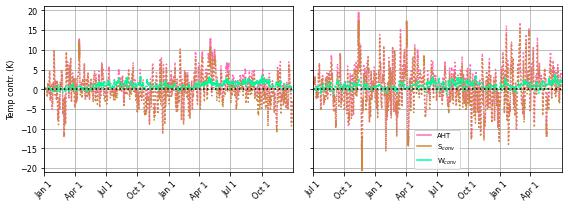

In [59]:
# create figure object
fig, axes = plt.subplots(figsize=(8,3),ncols=2,sharey=True)

axes[0].plot(xs,AHT_arc_jan.mean(dim='ens'),color='hotpink',linestyle='dotted')
axes[0].plot(xs,AHT_arc_jan.mean(dim='ens').where(get_pvals(AHT_arc_jan)<0.05),
             color='hotpink',label='Total')
# axes[0].plot(xs,Sconv_diff_jan.mean(dim='ens').rolling(time=15,min_periods=1).mean(),color='hotpink',linestyle='dotted')
axes[0].plot(xs,Sconv_arc_jan.mean(dim='ens'),color='peru',linestyle='dotted')
axes[0].plot(xs,Sconv_arc_jan.mean(dim='ens').where(get_pvals(Sconv_arc_jan)<0.05),
             color='peru',label=r'S$_{conv}$')
axes[0].plot(xs,Wconv_arc_jan.mean(dim='ens'),color='mediumspringgreen',linestyle='dotted')
axes[0].plot(xs,Wconv_arc_jan.mean(dim='ens').where(get_pvals(Wconv_arc_jan)<0.05),
             color='mediumspringgreen',label=r'W$_{conv}$')
axes[0].set_xticks(x_vals_jan)
axes[0].set_xticklabels(x_labs_jan)

axes[1].plot(xs,AHT_arc_jul.mean(dim='ens'),color='hotpink',linestyle='dotted')
axes[1].plot(xs,AHT_arc_jul.mean(dim='ens').where(get_pvals(AHT_arc_jul)<0.05),
             color='hotpink',label='AHT')
axes[1].plot(xs,Sconv_arc_jul.mean(dim='ens'),color='peru',linestyle='dotted')
axes[1].plot(xs,Sconv_arc_jul.mean(dim='ens').where(get_pvals(Sconv_arc_jul)<0.05),
             color='peru',label=r'S$_{conv}$')
axes[1].plot(xs,Wconv_arc_jul.mean(dim='ens'),color='mediumspringgreen',linestyle='dotted')
axes[1].plot(xs,Wconv_arc_jul.mean(dim='ens').where(get_pvals(Wconv_arc_jul)<0.05),
             color='mediumspringgreen',label=r'W$_{conv}$')
axes[1].set_xticks(x_vals_jul)
axes[1].set_xticklabels(x_labs_jul)

axes[1].legend(fontsize=7)

for ax in axes:
    ax.set_xlim([1,731])
    ax.set_ylim([-21,21])
    # ax.set_yticks(np.arange(-15,16,3))
    ax.tick_params(axis='x', rotation=45,labelsize=8)
    ax.tick_params(axis='y',labelsize=8)
    ax.grid()
    ax.hlines(0,1,731,color='black',linestyle=':')

axes[0].set_ylabel(r'Temp contr. (K)',fontsize=8)

# plt.title('Global feedback temp contributions',fontsize=10)
plt.tight_layout()
plt.show()

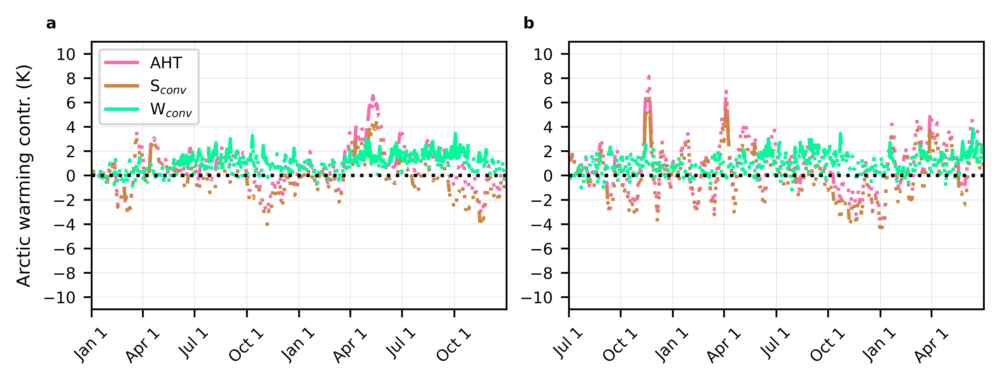

In [60]:
# create figure object
fig, axes = plt.subplots(figsize=(6.27,2.3),ncols=2,sharey=True,dpi=1000)

axes[0].plot(xs,AHT_arc_jan.mean(dim='ens').rolling(time=15,min_periods=1).mean(),color='hotpink',linestyle=(0,(1,3)))
axes[0].plot(xs,AHT_arc_jan.mean(dim='ens').rolling(time=15,min_periods=1).mean().where(get_pvals(AHT_arc_jan)<0.05),
             color='hotpink',label='AHT')
# axes[0].plot(xs,Sconv_diff_jan.mean(dim='ens').rolling(time=15,min_periods=1).mean(),color='hotpink',linestyle='dotted')
axes[0].plot(xs,Sconv_arc_jan.mean(dim='ens').rolling(time=15,min_periods=1).mean(),color='peru',linestyle=(0,(1,3)))
axes[0].plot(xs,Sconv_arc_jan.mean(dim='ens').rolling(time=15,min_periods=1).mean().where(get_pvals(Sconv_arc_jan)<0.05),
             color='peru',label=r'S$_{conv}$')
axes[0].plot(xs,Wconv_arc_jan.mean(dim='ens'),color='mediumspringgreen',linestyle=(0,(1,3)))
axes[0].plot(xs,Wconv_arc_jan.mean(dim='ens').where(get_pvals(Wconv_arc_jan)<0.05),
             color='mediumspringgreen',label=r'W$_{conv}$')
axes[0].set_xticks(x_vals_jan)
axes[0].set_xticklabels(x_labs_jan)

axes[1].plot(xs,AHT_arc_jul.mean(dim='ens').rolling(time=15,min_periods=1).mean(),color='hotpink',linestyle=(0,(1,3)))
axes[1].plot(xs,AHT_arc_jul.mean(dim='ens').rolling(time=15,min_periods=1).mean().where(get_pvals(AHT_arc_jul)<0.05),
             color='hotpink',label='AHT')
axes[1].plot(xs,Sconv_arc_jul.mean(dim='ens').rolling(time=15,min_periods=1).mean(),color='peru',linestyle=(0,(1,3)))
axes[1].plot(xs,Sconv_arc_jul.mean(dim='ens').rolling(time=15,min_periods=1).mean().where(get_pvals(Sconv_arc_jul)<0.05),
             color='peru',label=r'S$_{conv}$')
axes[1].plot(xs,Wconv_arc_jul.mean(dim='ens'),color='mediumspringgreen',linestyle=(0,(1,3)))
axes[1].plot(xs,Wconv_arc_jul.mean(dim='ens').where(get_pvals(Wconv_arc_jul)<0.05),
             color='mediumspringgreen',label=r'W$_{conv}$')
axes[1].set_xticks(x_vals_jul)
axes[1].set_xticklabels(x_labs_jul)

axes[0].legend(fontsize=7,loc='upper left')

for ax in axes:
    ax.set_xlim([1,731])
    ax.set_ylim([-11,11])
    ax.set_yticks(np.arange(-10,11,2))
    ax.tick_params(labelleft=True)
    ax.tick_params(axis='x', rotation=45,labelsize=7)
    ax.tick_params(axis='y',labelsize=7)
    ax.grid(linewidth=0.1)
    ax.hlines(0,1,731,color='black',linestyle=':')

axes[0].set_ylabel(r'Arctic warming contr. (K)',fontsize=8)

plt.tight_layout()
plt.subplots_adjust(wspace=0.15)
letters = ['a','b']
for i,ax in enumerate(axes):
    ax.text(-0.11,1.05,letters[i],transform=ax.transAxes,fontsize=7,fontweight='bold')

plt.savefig('Fig5_AHT_time_series.jpg',dpi=1000,bbox_inches='tight')
plt.show()

In [61]:
# january
lead = '/dx02/janoski/cesm/spat_avg_feedbacks/norm_feedbacks/all/b40.1850.cam5-lens.01.arc_'
AHT_arc_jan = xr.open_dataarray(lead+'AHT.nc')
Sconv_arc_jan = xr.open_dataarray(lead+'Sconv.nc')
Wconv_arc_jan = xr.open_dataarray(lead+'Wconv.nc')

# july
lead = '/dx02/janoski/cesm/spat_avg_feedbacks/norm_feedbacks/all/b40.1850.cam5-lens.07.arc_'
AHT_arc_jul = xr.open_dataarray(lead+'AHT.nc')
Sconv_arc_jul = xr.open_dataarray(lead+'Sconv.nc')
Wconv_arc_jul = xr.open_dataarray(lead+'Wconv.nc')

# Get some variables for relabeling the x-axes
first_days_jan = np.array([1,91,182,274])

x_vals_jan = np.concatenate((first_days_jan,first_days_jan+365))
x_labs_jan = np.tile(['Jan 1','Apr 1','Jul 1','Oct 1'],
                 (2))

first_days_jul = np.array([1,92,184,274])
x_vals_jul = np.concatenate((first_days_jul,first_days_jul+365))
x_labs_jul = np.tile(['Jul 1','Oct 1','Jan 1','Apr 1'],
                 (2))

xs=np.arange(1,731,1)

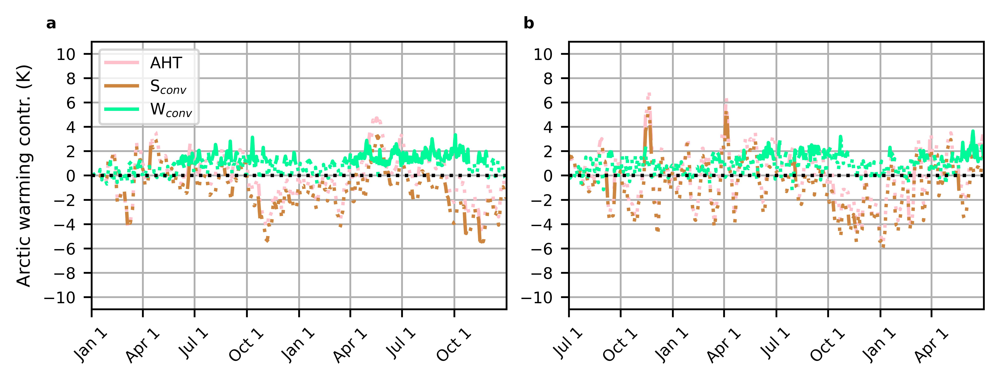

In [77]:
# create figure object
fig, axes = plt.subplots(figsize=(6.27,2.3),ncols=2,sharey=True,dpi=1000)

axes[0].plot(xs,AHT_arc_jan.mean(dim='ens').rolling(time=15,min_periods=1).mean(),color='pink',linestyle=(0,(1,3)))
axes[0].plot(xs,AHT_arc_jan.mean(dim='ens').rolling(time=15,min_periods=1).mean().where(get_pvals(AHT_arc_jan)<0.05),
             color='pink',label='AHT')
# axes[0].plot(xs,Sconv_diff_jan.mean(dim='ens').rolling(time=15,min_periods=1).mean(),color='pink',linestyle='dotted')
axes[0].plot(xs,Sconv_arc_jan.mean(dim='ens').rolling(time=15,min_periods=1).mean(),color='peru',linestyle=(0,(1,3)))
axes[0].plot(xs,Sconv_arc_jan.mean(dim='ens').rolling(time=15,min_periods=1).mean().where(get_pvals(Sconv_arc_jan)<0.05),
             color='peru',label=r'S$_{conv}$')
axes[0].plot(xs,Wconv_arc_jan.mean(dim='ens'),color='mediumspringgreen',linestyle=(0,(1,3)))
axes[0].plot(xs,Wconv_arc_jan.mean(dim='ens').where(get_pvals(Wconv_arc_jan)<0.05),
             color='mediumspringgreen',label=r'W$_{conv}$')
axes[0].set_xticks(x_vals_jan)
axes[0].set_xticklabels(x_labs_jan)

axes[1].plot(xs,AHT_arc_jul.mean(dim='ens').rolling(time=15,min_periods=1).mean(),color='pink',linestyle=(0,(1,3)))
axes[1].plot(xs,AHT_arc_jul.mean(dim='ens').rolling(time=15,min_periods=1).mean().where(get_pvals(AHT_arc_jul)<0.05),
             color='pink',label='AHT')
axes[1].plot(xs,Sconv_arc_jul.mean(dim='ens').rolling(time=15,min_periods=1).mean(),color='peru',linestyle=(0,(1,3)))
axes[1].plot(xs,Sconv_arc_jul.mean(dim='ens').rolling(time=15,min_periods=1).mean().where(get_pvals(Sconv_arc_jul)<0.05),
             color='peru',label=r'S$_{conv}$')
axes[1].plot(xs,Wconv_arc_jul.mean(dim='ens'),color='mediumspringgreen',linestyle=(0,(1,3)))
axes[1].plot(xs,Wconv_arc_jul.mean(dim='ens').where(get_pvals(Wconv_arc_jul)<0.05),
             color='mediumspringgreen',label=r'W$_{conv}$')
axes[1].set_xticks(x_vals_jul)
axes[1].set_xticklabels(x_labs_jul)

axes[0].legend(fontsize=7,loc='upper left')

for ax in axes:
    ax.set_xlim([1,731])
    ax.set_ylim([-11,11])
    ax.set_yticks(np.arange(-10,11,2))
    ax.tick_params(labelleft=True)
    ax.tick_params(axis='x', rotation=45,labelsize=7)
    ax.tick_params(axis='y',labelsize=7)
    ax.grid()
    ax.hlines(0,1,731,color='black',linestyle=':')

axes[0].set_ylabel(r'Arctic warming contr. (K)',fontsize=8)

plt.tight_layout()
plt.subplots_adjust(wspace=0.15)
letters = ['a','b']
for i,ax in enumerate(axes):
    ax.text(-0.11,1.05,letters[i],transform=ax.transAxes,fontsize=7,fontweight='bold')

plt.savefig('FigS5_AHT_as_residual_time_series.jpg',dpi=1000,bbox_inches='tight')
plt.show()

In [62]:
# january
lead = '/dx02/janoski/cesm/spat_avg_feedbacks/norm_feedbacks/all/b40.1850.cam5-lens.01.arc_'
AHT_jan_expl = xr.open_dataarray(lead+'AHT_expl.nc')
AHT_jan_resi = xr.open_dataarray(lead+'AHT.nc')

# july
lead = '/dx02/janoski/cesm/spat_avg_feedbacks/norm_feedbacks/all/b40.1850.cam5-lens.07.arc_'
AHT_jul_expl = xr.open_dataarray(lead+'AHT_expl.nc')
AHT_jul_resi = xr.open_dataarray(lead+'AHT.nc')

# Get some variables for relabeling the x-axes
first_days_jan = np.array([1,91,182,274])

x_vals_jan = np.concatenate((first_days_jan,first_days_jan+365))
x_labs_jan = np.tile(['Jan 1','Apr 1','Jul 1','Oct 1'],
                 (2))

first_days_jul = np.array([1,92,184,274])
x_vals_jul = np.concatenate((first_days_jul,first_days_jul+365))
x_labs_jul = np.tile(['Jul 1','Oct 1','Jan 1','Apr 1'],
                 (2))

xs=np.arange(1,731,1)

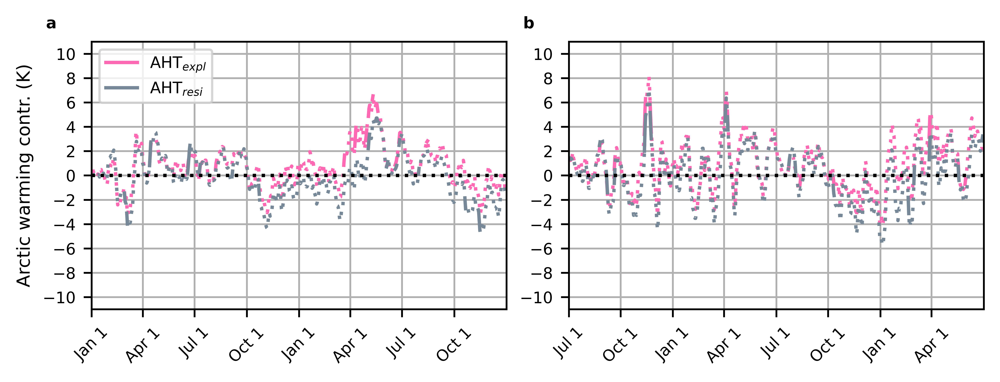

In [65]:
# create figure object
fig, axes = plt.subplots(figsize=(6.27,2.3),ncols=2,sharey=True,dpi=1000)

axes[0].plot(xs,AHT_jan_expl.mean(dim='ens').rolling(time=15,min_periods=1).mean(),color='hotpink',linestyle=(0,(1,2)))
axes[0].plot(xs,AHT_jan_expl.mean(dim='ens').rolling(time=15,min_periods=1).mean().where(get_pvals(AHT_jan_expl)<0.05),
             color='hotpink',label=r'AHT$_{expl}$')
axes[0].plot(xs,AHT_jan_resi.mean(dim='ens').rolling(time=15,min_periods=1).mean(),color='lightslategray',linestyle=(0,(1,2)))
axes[0].plot(xs,AHT_jan_resi.mean(dim='ens').rolling(time=15,min_periods=1).mean().where(get_pvals(AHT_jan_resi)<0.05),
             color='lightslategray',label=r'AHT$_{resi}$')
axes[0].set_xticks(x_vals_jan)
axes[0].set_xticklabels(x_labs_jan)

axes[1].plot(xs,AHT_jul_expl.mean(dim='ens').rolling(time=15,min_periods=1).mean(),color='hotpink',linestyle=(0,(1,2)))
axes[1].plot(xs,AHT_jul_expl.mean(dim='ens').rolling(time=15,min_periods=1).mean().where(get_pvals(AHT_jul_expl)<0.05),
             color='hotpink',label='AHT')
axes[1].plot(xs,AHT_jul_resi.mean(dim='ens').rolling(time=15,min_periods=1).mean(),color='lightslategray',linestyle=(0,(1,2)))
axes[1].plot(xs,AHT_jul_resi.mean(dim='ens').rolling(time=15,min_periods=1).mean().where(get_pvals(AHT_jul_resi)<0.05),
             color='lightslategray',label=r'AHT$_resi$')
axes[1].set_xticks(x_vals_jul)
axes[1].set_xticklabels(x_labs_jul)

axes[0].legend(fontsize=7,loc='upper left')

for ax in axes:
    ax.set_xlim([1,731])
    ax.set_ylim([-11,11])
    ax.set_yticks(np.arange(-10,11,2))
    ax.tick_params(labelleft=True)
    ax.tick_params(axis='x', rotation=45,labelsize=7)
    ax.tick_params(axis='y',labelsize=7)
    ax.grid()
    ax.hlines(0,1,731,color='black',linestyle=':')

axes[0].set_ylabel(r'Arctic warming contr. (K)',fontsize=8)

plt.tight_layout()
plt.subplots_adjust(wspace=0.15)
letters = ['a','b']
for i,ax in enumerate(axes):
    ax.text(-0.11,1.05,letters[i],transform=ax.transAxes,fontsize=7,fontweight='bold')

plt.savefig('FigS5_AHT_resi_expl_comparison.jpg',dpi=1000,bbox_inches='tight')
plt.show()

## F$_{sfc}$ vs. time

In [24]:
# january
lead = '/dx02/janoski/cesm/spat_avg_feedbacks/norm_feedbacks/all/b40.1850.cam5-lens.01.arc_'
alb_arc_jan = -1 * xr.open_dataarray(lead+'alb_sfc.nc')
cloud_LW_arc_jan = -1 * xr.open_dataarray(lead+'cloud_LW_sfc.nc')
cloud_SW_arc_jan = -1 * xr.open_dataarray(lead+'cloud_SW_sfc.nc')
cloud_arc_jan = cloud_LW_arc_jan + cloud_SW_arc_jan
lh_arc_jan = xr.open_dataarray(lead+'dLHFLX.nc')
Fsfc_arc_jan = xr.open_dataarray(lead+'Fsfc.nc')
Ta_arc_jan = -1 * xr.open_dataarray(lead+'Ta_tropo_sfc.nc')
Ts_arc_jan = -1 * xr.open_dataarray(lead+'Ts_tropo_sfc.nc')
q_LW_arc_jan = -1 * xr.open_dataarray(lead+'q_LW_tropo_sfc.nc')
q_SW_arc_jan = -1 * xr.open_dataarray(lead+'q_SW_tropo_sfc.nc')
q_arc_jan = q_LW_arc_jan + q_SW_arc_jan
sh_arc_jan = xr.open_dataarray(lead+'dSHFLX.nc')

# january
lead = '/dx02/janoski/cesm/spat_avg_feedbacks/norm_feedbacks/all/b40.1850.cam5-lens.01.glb_'
alb_glb_jan = -1 * xr.open_dataarray(lead+'alb_sfc.nc')
cloud_LW_glb_jan = -1 * xr.open_dataarray(lead+'cloud_LW_sfc.nc')
cloud_SW_glb_jan = -1 * xr.open_dataarray(lead+'cloud_SW_sfc.nc')
cloud_glb_jan = cloud_LW_glb_jan + cloud_SW_glb_jan
Fsfc_glb_jan = xr.open_dataarray(lead+'Fsfc.nc')
lh_glb_jan = xr.open_dataarray(lead+'dLHFLX.nc')
Ta_glb_jan = -1 * xr.open_dataarray(lead+'Ta_tropo_sfc.nc')
Ts_glb_jan = -1 * xr.open_dataarray(lead+'Ts_tropo_sfc.nc')
q_LW_glb_jan = -1 * xr.open_dataarray(lead+'q_LW_tropo_sfc.nc')
q_SW_glb_jan = -1 * xr.open_dataarray(lead+'q_SW_tropo_sfc.nc')
q_glb_jan = q_LW_glb_jan + q_SW_glb_jan
sh_glb_jan = xr.open_dataarray(lead+'dSHFLX.nc')

In [25]:
# july
lead = '/dx02/janoski/cesm/spat_avg_feedbacks/norm_feedbacks/all/b40.1850.cam5-lens.07.arc_'
alb_arc_jul = -1 * xr.open_dataarray(lead+'alb_sfc.nc')
cloud_LW_arc_jul = -1 * xr.open_dataarray(lead+'cloud_LW_sfc.nc')
cloud_SW_arc_jul = -1 * xr.open_dataarray(lead+'cloud_SW_sfc.nc')
cloud_arc_jul = cloud_LW_arc_jul + cloud_SW_arc_jul
Fsfc_arc_jul = xr.open_dataarray(lead+'Fsfc.nc')
lh_arc_jul = xr.open_dataarray(lead+'dLHFLX.nc')
Ta_arc_jul = -1 * xr.open_dataarray(lead+'Ta_tropo_sfc.nc')
Ts_arc_jul = -1 * xr.open_dataarray(lead+'Ts_tropo_sfc.nc')
q_LW_arc_jul = -1 * xr.open_dataarray(lead+'q_LW_tropo_sfc.nc')
q_SW_arc_jul = -1 * xr.open_dataarray(lead+'q_SW_tropo_sfc.nc')
q_arc_jul = q_LW_arc_jul + q_SW_arc_jul
sh_arc_jul = xr.open_dataarray(lead+'dSHFLX.nc')

# july
lead = '/dx02/janoski/cesm/spat_avg_feedbacks/norm_feedbacks/all/b40.1850.cam5-lens.07.glb_'
alb_glb_jul = -1 * xr.open_dataarray(lead+'alb_sfc.nc')
cloud_LW_glb_jul = -1 * xr.open_dataarray(lead+'cloud_LW_sfc.nc')
cloud_SW_glb_jul = -1 * xr.open_dataarray(lead+'cloud_SW_sfc.nc')
cloud_glb_jul = cloud_LW_glb_jul + cloud_SW_glb_jul
Fsfc_glb_jul = xr.open_dataarray(lead+'Fsfc.nc')
lh_glb_jul = xr.open_dataarray(lead+'dLHFLX.nc')
Ta_glb_jul = -1 * xr.open_dataarray(lead+'Ta_tropo_sfc.nc')
Ts_glb_jul = -1 * xr.open_dataarray(lead+'Ts_tropo_sfc.nc')
q_LW_glb_jul = -1 * xr.open_dataarray(lead+'q_LW_tropo_sfc.nc')
q_SW_glb_jul = -1 * xr.open_dataarray(lead+'q_SW_tropo_sfc.nc')
q_glb_jul = q_LW_glb_jul + q_SW_glb_jul
sh_glb_jul = xr.open_dataarray(lead+'dSHFLX.nc')

In [26]:
# get differences

alb_diff_jan = alb_arc_jan - alb_glb_jan
cloud_LW_diff_jan = cloud_LW_arc_jan - cloud_LW_glb_jan
cloud_SW_diff_jan = cloud_SW_arc_jan - cloud_SW_glb_jan
cloud_diff_jan = cloud_LW_diff_jan + cloud_SW_diff_jan
Fsfc_diff_jan = Fsfc_arc_jan - Fsfc_glb_jan
lh_diff_jan = lh_arc_jan - lh_glb_jan
Ta_diff_jan = Ta_arc_jan - Ta_glb_jan
Ts_diff_jan = Ts_arc_jan - Ts_glb_jan
q_LW_diff_jan = q_LW_arc_jan - q_LW_glb_jan
q_SW_diff_jan = q_SW_arc_jan - q_SW_glb_jan
q_diff_jan = q_LW_diff_jan + q_SW_diff_jan
sh_diff_jan = sh_arc_jan - sh_glb_jan

alb_diff_jul = alb_arc_jul - alb_glb_jul
cloud_LW_diff_jul = cloud_LW_arc_jul - cloud_LW_glb_jul
cloud_SW_diff_jul = cloud_SW_arc_jul - cloud_SW_glb_jul
cloud_diff_jul = cloud_LW_diff_jul + cloud_SW_diff_jul
Fsfc_diff_jul = Fsfc_arc_jul - Fsfc_glb_jul
lh_diff_jul = lh_arc_jul - lh_glb_jul
Ta_diff_jul = Ta_arc_jul - Ta_glb_jul
Ts_diff_jul = Ts_arc_jul - Ts_glb_jul
q_LW_diff_jul = q_LW_arc_jul - q_LW_glb_jul
q_SW_diff_jul = q_SW_arc_jul - q_SW_glb_jul
q_diff_jul = q_LW_diff_jul + q_SW_diff_jul
sh_diff_jul = sh_arc_jul - sh_glb_jul

In [27]:
# Get some variables for relabeling the x-axes
first_days_jan = np.array([1,91,182,274])

x_vals_jan = np.concatenate((first_days_jan,first_days_jan+365))
x_labs_jan = np.tile(['Jan 1','Apr 1','Jul 1','Oct 1'],
                 (2))

first_days_jul = np.array([1,92,184,274])
x_vals_jul = np.concatenate((first_days_jul,first_days_jul+365))
x_labs_jul = np.tile(['Jul 1','Oct 1','Jan 1','Apr 1'],
                 (2))

xs=np.arange(1,731,1)

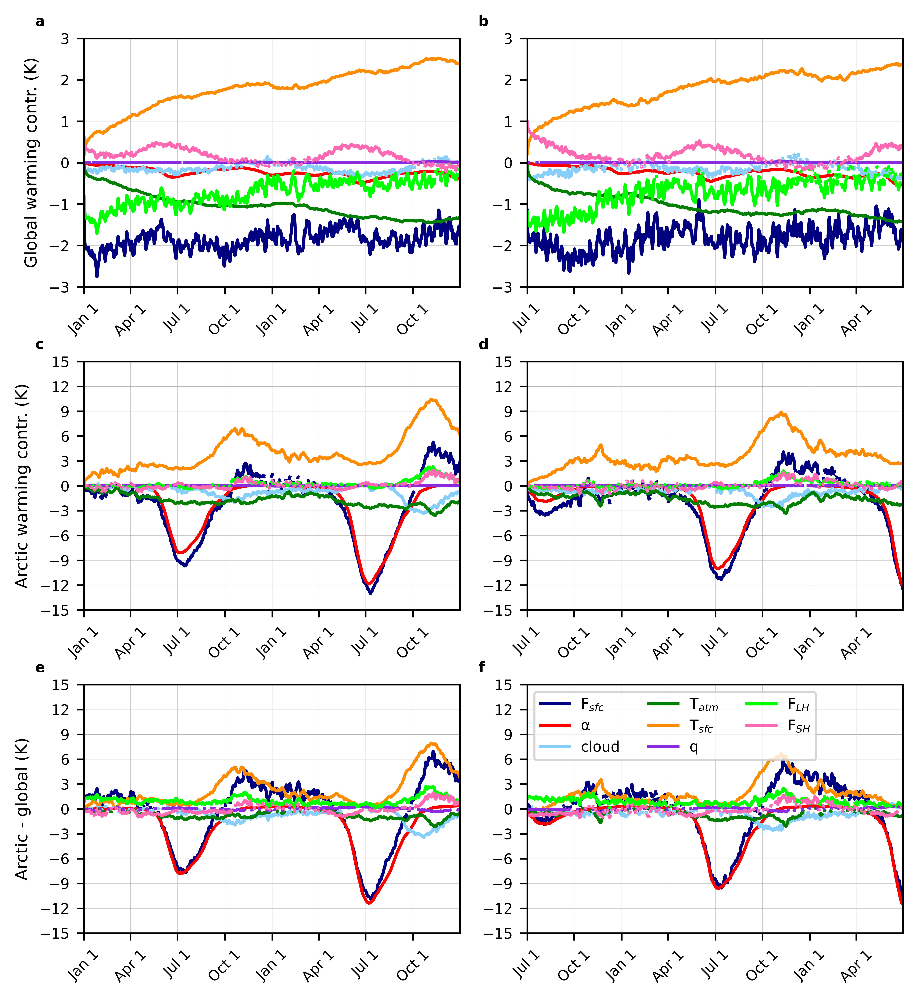

In [31]:
fig, axes = plt.subplots(ncols=2,nrows=3,sharey='row',figsize=(6.27,6.7),dpi=1000)

for ax in axes.flatten():
    ax.grid(linewidth=0.1)
    ax.set_xlim(1,730)
    ax.tick_params(axis='x', rotation=45,labelsize=7)
    ax.tick_params(axis='both',labelsize=7)
    ax.tick_params(labelleft=True)
    
#======================GLOBAL==============================
axes[0,0].plot(xs,Fsfc_glb_jan.mean(dim='ens'),color='navy',linestyle='dotted')
axes[0,0].plot(xs,Fsfc_glb_jan.mean(dim='ens').where(get_pvals(Fsfc_glb_jan)<0.05),
             color='navy',label=r'F$_{sfc}$')
axes[0,0].plot(xs,alb_glb_jan.mean(dim='ens'),color='red',linestyle='dotted')
axes[0,0].plot(xs,alb_glb_jan.mean(dim='ens').where(get_pvals(alb_glb_jan)<0.05),
             color='red',label='α')
axes[0,0].plot(xs,cloud_glb_jan.mean(dim='ens'),color='lightskyblue',linestyle='dotted')
axes[0,0].plot(xs,cloud_glb_jan.mean(dim='ens').where(get_pvals(cloud_glb_jan)<0.05),
             color='lightskyblue',label='cloud')
axes[0,0].plot(xs,Ta_glb_jan.mean(dim='ens'),color='green',linestyle='dotted')
axes[0,0].plot(xs,Ta_glb_jan.mean(dim='ens').where(get_pvals(Ta_glb_jan)<0.05),
             color='green',label=r'T$_{atm}$')
axes[0,0].plot(xs,Ts_glb_jan.mean(dim='ens'),color='darkorange',linestyle='dotted')
axes[0,0].plot(xs,Ts_glb_jan.mean(dim='ens').where(get_pvals(Ts_glb_jan)<0.05),
             color='darkorange',label=r'T$_{sfc}$')
axes[0,0].plot(xs,q_glb_jan.mean(dim='ens'),color='blueviolet',linestyle='dotted')
axes[0,0].plot(xs,q_glb_jan.mean(dim='ens').where(get_pvals(q_glb_jan)<0.05),
             color='blueviolet',label='q')
axes[0,0].plot(xs,lh_glb_jan.mean(dim='ens'),color='lime',linestyle='dotted')
axes[0,0].plot(xs,lh_glb_jan.mean(dim='ens').where(get_pvals(lh_glb_jan)<0.05),
             color='lime',label=r'LH$_{flux}$')
axes[0,0].plot(xs,sh_glb_jan.mean(dim='ens'),color='hotpink',linestyle='dotted')
axes[0,0].plot(xs,sh_glb_jan.mean(dim='ens').where(get_pvals(sh_glb_jan)<0.05),
             color='hotpink',label=r'SH$_{flux}$')
axes[0,0].set_xticks(x_vals_jan)
axes[0,0].set_xticklabels(x_labs_jan)


axes[0,1].plot(xs,Fsfc_glb_jul.mean(dim='ens'),color='navy',linestyle='dotted')
axes[0,1].plot(xs,Fsfc_glb_jul.mean(dim='ens').where(get_pvals(Fsfc_glb_jul)<0.05),
             color='navy',label=r'F$_{sfc}$')
axes[0,1].plot(xs,alb_glb_jul.mean(dim='ens'),color='red',linestyle='dotted')
axes[0,1].plot(xs,alb_glb_jul.mean(dim='ens').where(get_pvals(alb_glb_jul)<0.05),
             color='red',label='α')
axes[0,1].plot(xs,cloud_glb_jul.mean(dim='ens'),color='lightskyblue',linestyle='dotted')
axes[0,1].plot(xs,cloud_glb_jul.mean(dim='ens').where(get_pvals(cloud_glb_jul)<0.05),
             color='lightskyblue',label='cloud')
axes[0,1].plot(xs,Ta_glb_jul.mean(dim='ens'),color='green',linestyle='dotted')
axes[0,1].plot(xs,Ta_glb_jul.mean(dim='ens').where(get_pvals(Ta_glb_jul)<0.05),
             color='green',label=r'T$_{atm}$')
axes[0,1].plot(xs,Ts_glb_jul.mean(dim='ens'),color='darkorange',linestyle='dotted')
axes[0,1].plot(xs,Ts_glb_jul.mean(dim='ens').where(get_pvals(Ts_glb_jul)<0.05),
             color='darkorange',label=r'T$_{sfc}$')
axes[0,1].plot(xs,q_glb_jul.mean(dim='ens'),color='blueviolet',linestyle='dotted')
axes[0,1].plot(xs,q_glb_jul.mean(dim='ens').where(get_pvals(q_glb_jul)<0.05),
             color='blueviolet',label='q')
axes[0,1].plot(xs,lh_glb_jul.mean(dim='ens'),color='lime',linestyle='dotted')
axes[0,1].plot(xs,lh_glb_jul.mean(dim='ens').where(get_pvals(lh_glb_jul)<0.05),
             color='lime',label=r'F$_{LH}$')
axes[0,1].plot(xs,sh_glb_jul.mean(dim='ens'),color='hotpink',linestyle='dotted')
axes[0,1].plot(xs,sh_glb_jul.mean(dim='ens').where(get_pvals(sh_glb_jul)<0.05),
             color='hotpink',label=r'F$_{SH}$')
axes[0,1].set_xticks(x_vals_jul)
axes[0,1].set_xticklabels(x_labs_jul)

axes[0,0].set_ylim(-3,3)
axes[0,0].set_yticks(np.arange(-3,4,1))

#======================ARCTIC==============================

# create figure object

axes[1,0].plot(xs,Fsfc_arc_jan.mean(dim='ens'),color='navy',linestyle='dotted')
axes[1,0].plot(xs,Fsfc_arc_jan.mean(dim='ens').where(get_pvals(Fsfc_arc_jan)<0.05),
             color='navy',label=r'F$_{LH}$')
axes[1,0].plot(xs,alb_arc_jan.mean(dim='ens'),color='red',linestyle='dotted')
axes[1,0].plot(xs,alb_arc_jan.mean(dim='ens').where(get_pvals(alb_arc_jan)<0.05),
             color='red',label='α')
axes[1,0].plot(xs,cloud_arc_jan.mean(dim='ens'),color='lightskyblue',linestyle='dotted')
axes[1,0].plot(xs,cloud_arc_jan.mean(dim='ens').where(get_pvals(cloud_arc_jan)<0.05),
             color='lightskyblue',label='cloud')
axes[1,0].plot(xs,Ta_arc_jan.mean(dim='ens'),color='green',linestyle='dotted')
axes[1,0].plot(xs,Ta_arc_jan.mean(dim='ens').where(get_pvals(Ta_arc_jan)<0.05),
             color='green',label=r'T$_{atm}$')
axes[1,0].plot(xs,Ts_arc_jan.mean(dim='ens'),color='darkorange',linestyle='dotted')
axes[1,0].plot(xs,Ts_arc_jan.mean(dim='ens').where(get_pvals(Ts_arc_jan)<0.05),
             color='darkorange',label=r'T$_{sfc}$')
axes[1,0].plot(xs,q_arc_jan.mean(dim='ens'),color='blueviolet',linestyle='dotted')
axes[1,0].plot(xs,q_arc_jan.mean(dim='ens').where(get_pvals(q_arc_jan)<0.05),
             color='blueviolet',label='q')
axes[1,0].plot(xs,lh_arc_jan.mean(dim='ens'),color='lime',linestyle='dotted')
axes[1,0].plot(xs,lh_arc_jan.mean(dim='ens').where(get_pvals(lh_arc_jan)<0.05),
             color='lime',label=r'LH$_{flux}$')
axes[1,0].plot(xs,sh_arc_jan.mean(dim='ens'),color='hotpink',linestyle='dotted')
axes[1,0].plot(xs,sh_arc_jan.mean(dim='ens').where(get_pvals(sh_arc_jan)<0.05),
             color='hotpink',label=r'F$_{SH}$')
axes[1,0].set_xticks(x_vals_jan)
axes[1,0].set_xticklabels(x_labs_jan)

axes[1,1].plot(xs,Fsfc_arc_jul.mean(dim='ens'),color='navy',linestyle='dotted')
axes[1,1].plot(xs,Fsfc_arc_jul.mean(dim='ens').where(get_pvals(Fsfc_arc_jul)<0.05),
             color='navy',label=r'F$_{sfc}$')
axes[1,1].plot(xs,alb_arc_jul.mean(dim='ens'),color='red',linestyle='dotted')
axes[1,1].plot(xs,alb_arc_jul.mean(dim='ens').where(get_pvals(alb_arc_jul)<0.05),
             color='red',label='α')
axes[1,1].plot(xs,cloud_arc_jul.mean(dim='ens'),color='lightskyblue',linestyle='dotted')
axes[1,1].plot(xs,cloud_arc_jul.mean(dim='ens').where(get_pvals(cloud_arc_jul)<0.05),
             color='lightskyblue',label='cloud')
axes[1,1].plot(xs,Ta_arc_jul.mean(dim='ens'),color='green',linestyle='dotted')
axes[1,1].plot(xs,Ta_arc_jul.mean(dim='ens').where(get_pvals(Ta_arc_jul)<0.05),
             color='green',label=r'T$_{atm}$')
axes[1,1].plot(xs,Ts_arc_jul.mean(dim='ens'),color='darkorange',linestyle='dotted')
axes[1,1].plot(xs,Ts_arc_jul.mean(dim='ens').where(get_pvals(Ts_arc_jul)<0.05),
             color='darkorange',label=r'T$_{sfc}$')
axes[1,1].plot(xs,q_arc_jul.mean(dim='ens'),color='blueviolet',linestyle='dotted')
axes[1,1].plot(xs,q_arc_jul.mean(dim='ens').where(get_pvals(q_arc_jul)<0.05),
             color='blueviolet',label='q')
axes[1,1].plot(xs,lh_arc_jul.mean(dim='ens'),color='lime',linestyle='dotted')
axes[1,1].plot(xs,lh_arc_jul.mean(dim='ens').where(get_pvals(lh_arc_jul)<0.05),
             color='lime',label=r'LH$_{flux}$')
axes[1,1].plot(xs,sh_arc_jul.mean(dim='ens'),color='hotpink',linestyle='dotted')
axes[1,1].plot(xs,sh_arc_jul.mean(dim='ens').where(get_pvals(sh_arc_jul)<0.05),
             color='hotpink',label=r'LH$_{flux}$')
axes[1,1].set_xticks(x_vals_jul)
axes[1,1].set_xticklabels(x_labs_jul)
axes[1,0].set_ylim(-15,15)
axes[1,0].set_yticks(np.arange(-15,16,3))

#======================DIFF==============================

axes[2,0].plot(xs,Fsfc_diff_jan.mean(dim='ens'),color='navy',linestyle='dotted')
axes[2,0].plot(xs,Fsfc_diff_jan.mean(dim='ens').where(get_pvals(Fsfc_diff_jan)<0.05),
             color='navy',label=r'F$_{sfc}$')
axes[2,0].plot(xs,alb_diff_jan.mean(dim='ens'),color='red',linestyle='dotted')
axes[2,0].plot(xs,alb_diff_jan.mean(dim='ens').where(get_pvals(alb_diff_jan)<0.05),
             color='red',label='α')
axes[2,0].plot(xs,cloud_diff_jan.mean(dim='ens'),color='lightskyblue',linestyle='dotted')
axes[2,0].plot(xs,cloud_diff_jan.mean(dim='ens').where(get_pvals(cloud_diff_jan)<0.05),
             color='lightskyblue',label='cloud')
axes[2,0].plot(xs,Ta_diff_jan.mean(dim='ens'),color='green',linestyle='dotted')
axes[2,0].plot(xs,Ta_diff_jan.mean(dim='ens').where(get_pvals(Ta_diff_jan)<0.05),
             color='green',label=r'T$_{atm}$')
axes[2,0].plot(xs,Ts_diff_jan.mean(dim='ens'),color='darkorange',linestyle='dotted')
axes[2,0].plot(xs,Ts_diff_jan.mean(dim='ens').where(get_pvals(Ts_diff_jan)<0.05),
             color='darkorange',label=r'T$_{sfc}$')
axes[2,0].plot(xs,q_diff_jan.mean(dim='ens'),color='blueviolet',linestyle='dotted')
axes[2,0].plot(xs,q_diff_jan.mean(dim='ens').where(get_pvals(q_diff_jan)<0.05),
             color='blueviolet',label='q')
axes[2,0].plot(xs,lh_diff_jan.mean(dim='ens'),color='lime',linestyle='dotted')
axes[2,0].plot(xs,lh_diff_jan.mean(dim='ens').where(get_pvals(lh_diff_jan)<0.05),
             color='lime',label=r'LH$_{flux}$')
axes[2,0].plot(xs,sh_diff_jan.mean(dim='ens'),color='hotpink',linestyle='dotted')
axes[2,0].plot(xs,sh_diff_jan.mean(dim='ens').where(get_pvals(sh_diff_jan)<0.05),
             color='hotpink',label=r'LH$_{flux}$')
axes[2,0].set_xticks(x_vals_jan)
axes[2,0].set_xticklabels(x_labs_jan)


axes[2,1].plot(xs,Fsfc_diff_jul.mean(dim='ens'),color='navy',linestyle='dotted')
axes[2,1].plot(xs,Fsfc_diff_jul.mean(dim='ens').where(get_pvals(Fsfc_diff_jul)<0.05),
             color='navy',label=r'F$_{sfc}$')
axes[2,1].plot(xs,alb_diff_jul.mean(dim='ens'),color='red',linestyle='dotted')
axes[2,1].plot(xs,alb_diff_jul.mean(dim='ens').where(get_pvals(alb_diff_jul)<0.05),
             color='red',label='α')
axes[2,1].plot(xs,cloud_diff_jul.mean(dim='ens'),color='lightskyblue',linestyle='dotted')
axes[2,1].plot(xs,cloud_diff_jul.mean(dim='ens').where(get_pvals(cloud_diff_jul)<0.05),
             color='lightskyblue',label='cloud')
axes[2,1].plot(xs,Ta_diff_jul.mean(dim='ens'),color='green',linestyle='dotted')
axes[2,1].plot(xs,Ta_diff_jul.mean(dim='ens').where(get_pvals(Ta_diff_jul)<0.05),
             color='green',label=r'T$_{atm}$')
axes[2,1].plot(xs,Ts_diff_jul.mean(dim='ens'),color='darkorange',linestyle='dotted')
axes[2,1].plot(xs,Ts_diff_jul.mean(dim='ens').where(get_pvals(Ts_diff_jul)<0.05),
             color='darkorange',label=r'T$_{sfc}$')
axes[2,1].plot(xs,q_diff_jul.mean(dim='ens'),color='blueviolet',linestyle='dotted')
axes[2,1].plot(xs,q_diff_jul.mean(dim='ens').where(get_pvals(q_diff_jul)<0.05),
             color='blueviolet',label='q')
axes[2,1].plot(xs,lh_diff_jul.mean(dim='ens'),color='lime',linestyle='dotted')
axes[2,1].plot(xs,lh_diff_jul.mean(dim='ens').where(get_pvals(lh_diff_jul)<0.05),
             color='lime',label=r'F$_{LH}$')
axes[2,1].plot(xs,sh_diff_jul.mean(dim='ens'),color='hotpink',linestyle='dotted')
axes[2,1].plot(xs,sh_diff_jul.mean(dim='ens').where(get_pvals(sh_diff_jul)<0.05),
             color='hotpink',label=r'F$_{SH}$')
axes[2,1].set_xticks(x_vals_jul)
axes[2,1].set_xticklabels(x_labs_jul)
axes[2,0].set_ylim(-15,15)
axes[2,0].set_yticks(np.arange(-15,16,3))
axes[2,1].legend(fontsize=7,ncol=3,loc='upper left')
axes[0,0].set_ylabel('Global warming contr. (K)',fontsize=8)
axes[1,0].set_ylabel('Arctic warming contr. (K)',fontsize=8)
axes[2,0].set_ylabel('Arctic - global (K)',fontsize=8)

    
plt.tight_layout()
plt.subplots_adjust(hspace=0.3)

letters = ['a','b','c','d','e','f']
for i,ax in enumerate(axes.flatten()):
    ax.text(-0.13,1.05,letters[i],transform=ax.transAxes,fontsize=7,fontweight='bold')
    
plt.savefig('Fig4_Fsfc_time_series.jpg',dpi=1000,bbox_inches='tight')
plt.show()

## CO$_2$ vs. time

In [12]:
# read in cell area file for taking spatial averages
areacella = xr.open_dataarray('/dx01/janoski/cesm/output/gridarea.nc')
area=areacella
# create function for taking spatial averages, while weighting for latitude
def spav(ds_in, areacella=areacella, lat_bound_s = -91, lat_bound_n = 91):
    """
    Use xarray/numpy to calculate spatial average while weighting for latitude.
    
    Keyword arguments:
    ds_in -- Dataset or DataArray to take the average of with coords lat and lon
    areacella -- Dataset or DataArray containing the grid cell area with coords lat and lon
    lat_bound_s -- float, Southern boundary of area to average
    lat_bound_n -- float, Northern boundary of area to average
    """
    ds_in = ds_in.sel(lat=slice(lat_bound_s,lat_bound_n))
    areacella = areacella.sel(lat=slice(lat_bound_s,lat_bound_n))
    out = (ds_in*(areacella/areacella.sum(dim=['lat','lon']))).sum(dim=['lat','lon'])
    return(out)

In [13]:
test = xr.open_dataset('/dx02/janoski/cesm/inst_rf/CAM4_inst_4xCO2_RF_2yr_regridded.nc',
                      use_cftime=True)

In [14]:
test = test.isel(time=slice(None,365))
test

<xarray.Dataset>
Dimensions:  (time: 365, lat: 192, lon: 288)
Coordinates:
  * time     (time) object 0001-01-01 12:00:00 ... 0001-12-31 12:00:00
  * lon      (lon) float64 0.0 1.25 2.5 3.75 5.0 ... 355.0 356.2 357.5 358.8
  * lat      (lat) float64 -90.0 -89.06 -88.12 -87.17 ... 87.17 88.12 89.06 90.0
Data variables:
    FLNS     (time, lat, lon) float64 ...
    FLNSC    (time, lat, lon) float64 ...
    FLNT     (time, lat, lon) float64 ...
    FLNTC    (time, lat, lon) float64 ...
    FSNS     (time, lat, lon) float64 ...
    FSNSC    (time, lat, lon) float64 ...
    FSNT     (time, lat, lon) float64 ...
    FSNTC    (time, lat, lon) float64 ...
Attributes:
    regrid_method:  bilinear

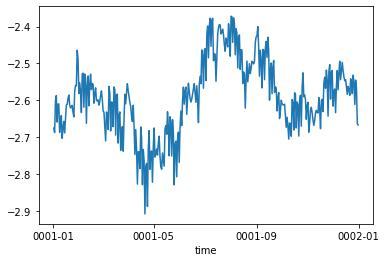

In [15]:
spav(test.FLNS - test.FSNS).plot()

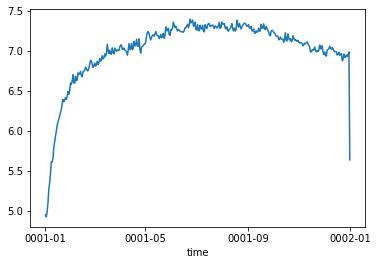

In [16]:
spav(test.FSNT - test.FLNT).plot()

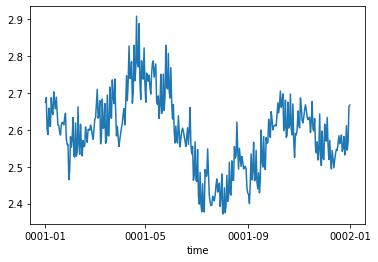

In [17]:
spav(test.FSNS -test.FLNS).plot()

In [18]:
# Get some variables for relabeling the x-axes
first_days_jan = np.array([1,32,60,91,121,152,182,213,244,274,305,335])

x_vals_jan = first_days_jan
x_labs_jan = ['Jan 1','Feb 1','Mar 1','Apr 1',
              'May 1','Jun 1','Jul 1','Aug 1',
              'Sep 1','Oct 1','Nov 1','Dec 1']

xs=np.arange(1,366,1)

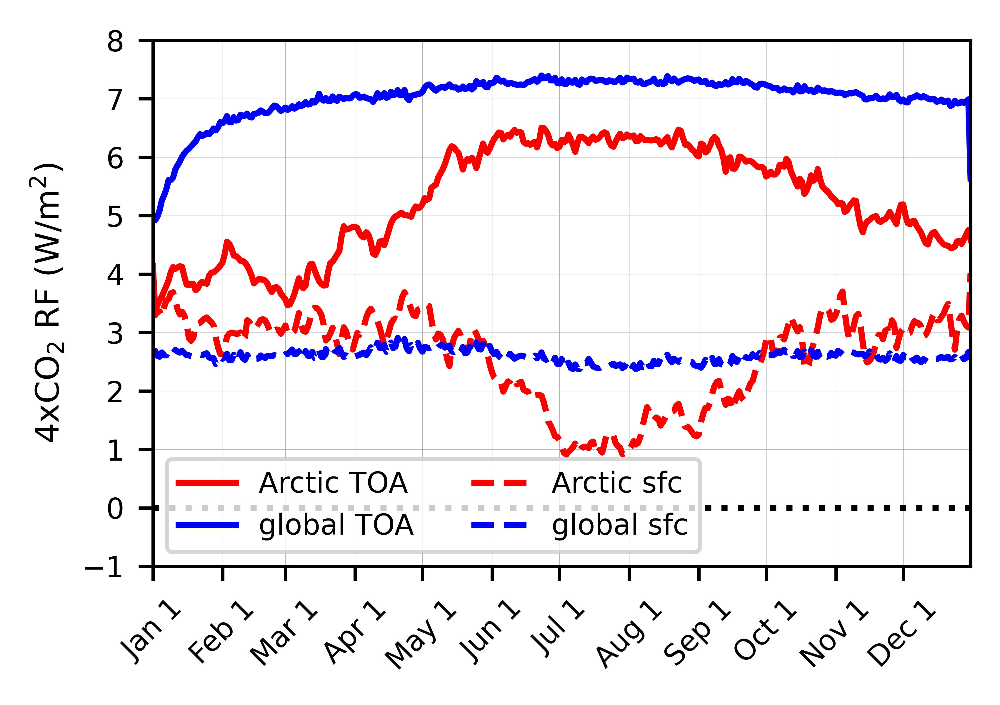

In [19]:
fig, ax = plt.subplots(figsize=(3.5,2.5),dpi=1000)

ax.grid(linewidth=0.1)
ax.set_xlim(1,365)
ax.tick_params(axis='x', rotation=45,labelsize=7)
ax.tick_params(axis='both',labelsize=7)
ax.tick_params(labelleft=True)
ax.set_ylim(-1,8)
# ax.set_yticks(np.arange(-4,15,2))
    
# top-left
ax.plot(xs,spav(test.FSNT - test.FLNT,lat_bound_s=70),color='red',label='Arctic TOA')
ax.plot(xs,spav(test.FSNT - test.FLNT),color='blue',label='global TOA')
ax.plot(xs,spav(test.FSNS - test.FLNS,lat_bound_s=70),color='red',label='Arctic sfc',linestyle='dashed')
ax.plot(xs,spav(test.FSNS - test.FLNS),color='blue',label='global sfc',linestyle='dashed')
ax.hlines(0,1,366,linestyle='dotted',color='black')
ax.set_xticks(x_vals_jan)
ax.set_xticklabels(x_labs_jan)
ax.set_ylabel(r'4xCO$_2$ RF (W/m$^2$)',fontsize=8)
ax.legend(fontsize=7,loc='lower left',ncol=2)

plt.tight_layout()

plt.savefig('FigS3_CO2_time_series.jpg',dpi=1000,bbox_inches='tight')
plt.show()

## Stratospheric feedbacks vs. time

In [32]:
# january
lead = '/dx02/janoski/cesm/spat_avg_feedbacks/norm_feedbacks/all/b40.1850.cam5-lens.01.arc_'
q_LW_arc_jan = xr.open_dataarray(lead+'q_LW_strato_TOA.nc')
q_SW_arc_jan = xr.open_dataarray(lead+'q_SW_strato_TOA.nc')
q_arc_jan = q_LW_arc_jan + q_SW_arc_jan
T_arc_jan = xr.open_dataarray(lead+'T_strato_TOA.nc')

lead = '/dx02/janoski/cesm/spat_avg_feedbacks/norm_feedbacks/all/b40.1850.cam5-lens.01.glb_'
q_LW_glb_jan = xr.open_dataarray(lead+'q_LW_strato_TOA.nc')
q_SW_glb_jan = xr.open_dataarray(lead+'q_SW_strato_TOA.nc')
q_glb_jan = q_LW_glb_jan + q_SW_glb_jan
T_glb_jan = xr.open_dataarray(lead+'T_strato_TOA.nc')

In [33]:
# jul
lead = '/dx02/janoski/cesm/spat_avg_feedbacks/norm_feedbacks/all/b40.1850.cam5-lens.07.arc_'
q_LW_arc_jul = xr.open_dataarray(lead+'q_LW_strato_TOA.nc')
q_SW_arc_jul = xr.open_dataarray(lead+'q_SW_strato_TOA.nc')
q_arc_jul = q_LW_arc_jul + q_SW_arc_jul
T_arc_jul = xr.open_dataarray(lead+'T_strato_TOA.nc')

lead = '/dx02/janoski/cesm/spat_avg_feedbacks/norm_feedbacks/all/b40.1850.cam5-lens.07.glb_'
q_LW_glb_jul = xr.open_dataarray(lead+'q_LW_strato_TOA.nc')
q_SW_glb_jul = xr.open_dataarray(lead+'q_SW_strato_TOA.nc')
q_glb_jul = q_LW_glb_jul + q_SW_glb_jul
T_glb_jul = xr.open_dataarray(lead+'T_strato_TOA.nc')

In [34]:
# diff
T_diff_jan = T_arc_jan - T_glb_jan
q_LW_diff_jan = q_LW_arc_jan - q_LW_glb_jan
q_SW_diff_jan = q_SW_arc_jan - q_SW_glb_jan
q_diff_jan = q_LW_diff_jan + q_SW_diff_jan

T_diff_jul = T_arc_jul - T_glb_jul
q_LW_diff_jul = q_LW_arc_jul - q_LW_glb_jul
q_SW_diff_jul = q_SW_arc_jul - q_SW_glb_jul
q_diff_jul = q_LW_diff_jul + q_SW_diff_jul

In [35]:
# Get some variables for relabeling the x-axes
first_days_jan = np.array([1,91,182,274])

x_vals_jan = np.concatenate((first_days_jan,first_days_jan+365))
x_labs_jan = np.tile(['Jan 1','Apr 1','Jul 1','Oct 1'],
                 (2))

first_days_jul = np.array([1,92,184,274])
x_vals_jul = np.concatenate((first_days_jul,first_days_jul+365))
x_labs_jul = np.tile(['Jul 1','Oct 1','Jan 1','Apr 1'],
                 (2))

xs=np.arange(1,731,1)

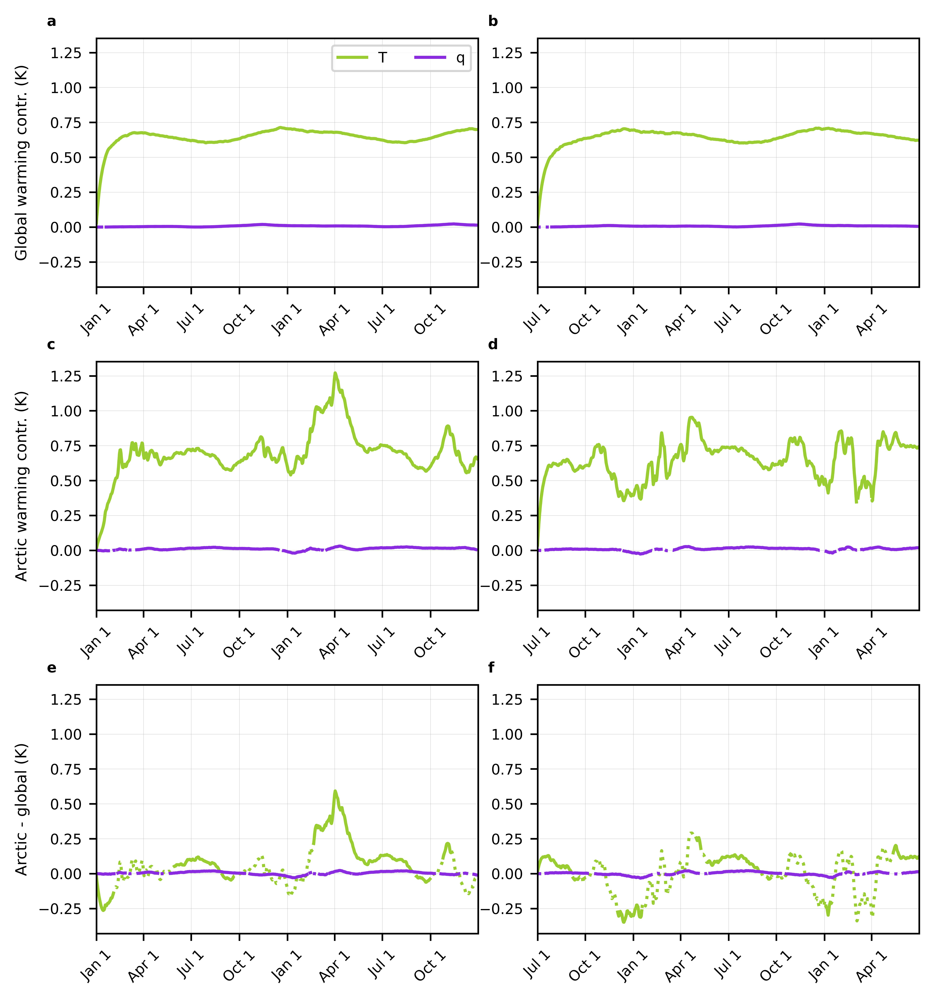

In [37]:
fig, axes = plt.subplots(ncols=2,nrows=3,sharey=True,figsize=(6.27,6.7),dpi=1000)

for ax in axes.flatten():
    ax.grid(linewidth=0.1)
    ax.set_xlim(1,730)
    ax.tick_params(axis='x', rotation=45,labelsize=7)
    ax.tick_params(axis='both',labelsize=7)
    ax.tick_params(labelleft=True)
    
#======================GLOBAL==============================
axes[0,0].set_ylabel('Global warming contr. (K)',fontsize=7.5)
axes[0,0].plot(xs,T_glb_jan.mean(dim='ens'),color='yellowgreen',linestyle='dotted')
axes[0,0].plot(xs,T_glb_jan.mean(dim='ens').where(get_pvals(T_glb_jan)<0.05),
             color='yellowgreen',label='T')
axes[0,0].plot(xs,q_glb_jan.mean(dim='ens'),color='blueviolet',linestyle='dotted')
axes[0,0].plot(xs,q_glb_jan.mean(dim='ens').where(get_pvals(q_glb_jan)<0.05),
             color='blueviolet',label='q')
axes[0,0].set_xticks(x_vals_jan)
axes[0,0].set_xticklabels(x_labs_jan)

axes[0,1].plot(xs,T_glb_jul.mean(dim='ens'),color='yellowgreen',linestyle='dotted')
axes[0,1].plot(xs,T_glb_jul.mean(dim='ens').where(get_pvals(T_glb_jul)<0.05),
             color='yellowgreen',label='T')
axes[0,1].plot(xs,q_glb_jul.mean(dim='ens'),color='blueviolet',linestyle='dotted')
axes[0,1].plot(xs,q_glb_jul.mean(dim='ens').where(get_pvals(q_glb_jul)<0.05),
             color='blueviolet',label='q')
axes[0,1].set_xticks(x_vals_jul)
axes[0,1].set_xticklabels(x_labs_jul)
# axes[0,1].set_ylim(-3,3)
# axes[0,1].set_yticks(np.arange(-3,4,1))

#======================ARCTIC==============================

# create figure object

axes[1,0].set_ylabel('Arctic warming contr. (K)',fontsize=7.5)
axes[1,0].plot(xs,T_arc_jan.mean(dim='ens'),color='yellowgreen',linestyle='dotted')
axes[1,0].plot(xs,T_arc_jan.mean(dim='ens').where(get_pvals(T_arc_jan)<0.05),
             color='yellowgreen',label='T')
axes[1,0].plot(xs,q_arc_jan.mean(dim='ens'),color='blueviolet',linestyle='dotted')
axes[1,0].plot(xs,q_arc_jan.mean(dim='ens').where(get_pvals(q_arc_jan)<0.05),
             color='blueviolet',label='q')
axes[1,0].set_xticks(x_vals_jan)
axes[1,0].set_xticklabels(x_labs_jan)

axes[1,1].plot(xs,T_arc_jul.mean(dim='ens'),color='yellowgreen',linestyle='dotted')
axes[1,1].plot(xs,T_arc_jul.mean(dim='ens').where(get_pvals(T_arc_jul)<0.05),
             color='yellowgreen',label='T')
axes[1,1].plot(xs,q_arc_jul.mean(dim='ens'),color='blueviolet',linestyle='dotted')
axes[1,1].plot(xs,q_arc_jul.mean(dim='ens').where(get_pvals(q_arc_jul)<0.05),
             color='blueviolet',label='q')
axes[1,1].set_xticks(x_vals_jul)
axes[1,1].set_xticklabels(x_labs_jul)
# axes[1,1].set_ylim(-15,15)
# axes[1,1].set_yticks(np.arange(-15,16,3))

#======================DIFF==============================

axes[2,0].set_ylabel('Arctic - global (K)',fontsize=7.5)
axes[2,0].plot(xs,T_diff_jan.mean(dim='ens'),color='yellowgreen',linestyle='dotted')
axes[2,0].plot(xs,T_diff_jan.mean(dim='ens').where(get_pvals(T_diff_jan)<0.05),
             color='yellowgreen',label='T')
axes[2,0].plot(xs,q_diff_jan.mean(dim='ens'),color='blueviolet',linestyle='dotted')
axes[2,0].plot(xs,q_diff_jan.mean(dim='ens').where(get_pvals(q_diff_jan)<0.05),
             color='blueviolet',label='q')
axes[2,0].set_xticks(x_vals_jan)
axes[2,0].set_xticklabels(x_labs_jan)

axes[2,1].plot(xs,T_diff_jul.mean(dim='ens'),color='yellowgreen',linestyle='dotted')
axes[2,1].plot(xs,T_diff_jul.mean(dim='ens').where(get_pvals(T_diff_jul)<0.05),
             color='yellowgreen',label='T')
axes[2,1].plot(xs,q_diff_jul.mean(dim='ens'),color='blueviolet',linestyle='dotted')
axes[2,1].plot(xs,q_diff_jul.mean(dim='ens').where(get_pvals(q_diff_jul)<0.05),
             color='blueviolet',label='q')
axes[2,1].set_xticks(x_vals_jul)
axes[2,1].set_xticklabels(x_labs_jul)
axes[0,0].legend(loc='best',fontsize=7,ncol=3)
# axes[2,1].set_ylim(-15,15)
# axes[2,1].set_yticks(np.arange(-15,16,3))

    
plt.tight_layout()
plt.subplots_adjust(hspace=0.3)

letters = ['a','b','c','d','e','f']
for i,ax in enumerate(axes.flatten()):
    ax.text(-0.13,1.05,letters[i],transform=ax.transAxes,fontsize=7,fontweight='bold')
    
plt.savefig('FigS4_strato_time_series.jpg',dpi=1000,bbox_inches='tight')
plt.show()